# Structure of the notebook 

### I. Data cleaning :

  #### 1. Checking data types.
  #### 2. Treatment of  missing data.
  #### 3. Checking the existence of duplicates.
  #### 4. Checking the existence of constant and quasi-constant features.
  #### 5. Verification of the data range constraint for numerical variables.
  #### 6. Investigation of the existence of rare labels in categorical variables.

### II. Exploratory data analysis

  #### 1. Exploring the distribution of numerical variables.
  #### 2. Exploring the distribution of the target variable.

### III. Tuning  and comparing the models.

 #### 1. Tuning the models.
 #### 2. Fitting the different pipelines.
 #### 3. Comparing the models.
 #### 4. Choosing the best model.

###  IV. Model interpretation using SHAP.


In [161]:
import re 
import time
import pandas as pd 
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns 
import statsmodels.api as sm
import pylab
from feature_engine.selection import DropConstantFeatures, DropDuplicateFeatures, SmartCorrelatedSelection
from feature_engine.encoding import RareLabelEncoder, OneHotEncoder, OrdinalEncoder, CountFrequencyEncoder, MeanEncoder, PRatioEncoder
from feature_engine.wrappers import SklearnTransformerWrapper
from feature_engine.outliers import OutlierTrimmer
import scipy.stats as stats
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier, AdaBoostClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import cross_val_score, train_test_split
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import StandardScaler, MinMaxScaler, RobustScaler
from sklearn.feature_selection import SelectKBest, mutual_info_classif
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay, classification_report, f1_score, precision_score, recall_score
from xgboost import XGBClassifier
import optuna
import shap
import pickle

In [5]:
df = pd.read_csv('customer_booking.csv',encoding = 'ISO-8859-1')
df.head()

,num_passengers,sales_channel,trip_type,purchase_lead,length_of_stay,flight_hour,flight_day,route,booking_origin,wants_extra_baggage,wants_preferred_seat,wants_in_flight_meals,flight_duration,booking_complete
0,2,Internet,RoundTrip,262,19,7,Sat,AKLDEL,New Zealand,1,0,0,5.52,0
1,1,Internet,RoundTrip,112,20,3,Sat,AKLDEL,New Zealand,0,0,0,5.52,0
2,2,Internet,RoundTrip,243,22,17,Wed,AKLDEL,India,1,1,0,5.52,0
3,1,Internet,RoundTrip,96,31,4,Sat,AKLDEL,New Zealand,0,0,1,5.52,0
4,2,Internet,RoundTrip,68,22,15,Wed,AKLDEL,India,1,0,1,5.52,0


### I. Data cleaning :


#### 1. Checking data types

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50000 entries, 0 to 49999
Data columns (total 14 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   num_passengers         50000 non-null  int64  
 1   sales_channel          50000 non-null  object 
 2   trip_type              50000 non-null  object 
 3   purchase_lead          50000 non-null  int64  
 4   length_of_stay         50000 non-null  int64  
 5   flight_hour            50000 non-null  int64  
 6   flight_day             50000 non-null  object 
 7   route                  50000 non-null  object 
 8   booking_origin         50000 non-null  object 
 9   wants_extra_baggage    50000 non-null  int64  
 10  wants_preferred_seat   50000 non-null  int64  
 11  wants_in_flight_meals  50000 non-null  int64  
 12  flight_duration        50000 non-null  float64
 13  booking_complete       50000 non-null  int64  
dtypes: float64(1), int64(8), object(5)
memory usage: 5.3+ 

In [7]:
df.describe()

,num_passengers,purchase_lead,length_of_stay,flight_hour,wants_extra_baggage,wants_preferred_seat,wants_in_flight_meals,flight_duration,booking_complete
count,50000.000000,50000.000000,50000.00000,50000.00000,50000.000000,50000.000000,50000.000000,50000.000000,50000.000000
mean,1.591240,84.940480,23.04456,9.06634,0.668780,0.296960,0.427140,7.277561,0.149560
std,1.020165,90.451378,33.88767,5.41266,0.470657,0.456923,0.494668,1.496863,0.356643
min,1.000000,0.000000,0.00000,0.00000,0.000000,0.000000,0.000000,4.670000,0.000000
25%,1.000000,21.000000,5.00000,5.00000,0.000000,0.000000,0.000000,5.620000,0.000000
50%,1.000000,51.000000,17.00000,9.00000,1.000000,0.000000,0.000000,7.570000,0.000000
75%,2.000000,115.000000,28.00000,13.00000,1.000000,1.000000,1.000000,8.830000,0.000000
max,9.000000,867.000000,778.00000,23.00000,1.000000,1.000000,1.000000,9.500000,1.000000


#### 2. Treatment of  missing data.

In [8]:
# A function to verify if there is some missing values in other forms than "NaN".
def miss_val(df, column, value):
    """ 
    A function to get the indices of the rows with missing values
    
        Inputs:
               - The dataframe object.
               - The name of the column.
               - The value to verify.
        Outputs:
               - list containing the indices of the rows with missing values
    """
    unique_vls = df[column].unique()
    null_rows = []
    for i in range(len(unique_vls)):
        if str(unique_vls[i]) == str(value):
            # returns the index of the missing column
            null_rows.append(df.loc[df[column]==unique_vls[i], df.columns].index)
    return null_rows

In [9]:
# Checking the following values.
vals = ['', '.', '?', ' ', 'MISSING', 'missing', 'Missing', '!', 'NULL', 'Null','null']

for column in df.columns :
    for j in vals:
        if len(miss_val(df, column, j))> 0:
            print("The used value for column '{0}' is '{1}'".format(column, j))
        


#### 3. Checking the existence of duplicates.

Duplicated rows can be a source of data leakage, so it is  a good practice to remove them.

In [10]:
# Getting the duplicated columns
dup = df.duplicated()
df[dup]

,num_passengers,sales_channel,trip_type,purchase_lead,length_of_stay,flight_hour,flight_day,route,booking_origin,wants_extra_baggage,wants_preferred_seat,wants_in_flight_meals,flight_duration,booking_complete
196,5,Internet,RoundTrip,206,17,13,Sun,AKLKUL,Malaysia,1,0,0,8.83,0
316,5,Internet,RoundTrip,206,17,13,Sun,AKLKUL,Malaysia,1,0,0,8.83,0
384,5,Internet,RoundTrip,206,17,13,Sun,AKLKUL,Malaysia,1,0,0,8.83,0
456,1,Internet,RoundTrip,30,85,15,Fri,AKLKUL,Malaysia,1,0,0,8.83,1
513,3,Internet,RoundTrip,109,20,4,Tue,AKLKUL,Singapore,1,0,1,8.83,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
49852,2,Internet,RoundTrip,204,6,14,Tue,PENTPE,Malaysia,1,0,0,4.67,0
49902,1,Mobile,RoundTrip,106,6,11,Fri,PENTPE,Taiwan,1,0,0,4.67,0
49934,1,Internet,RoundTrip,2,6,3,Thu,PENTPE,Malaysia,0,0,1,4.67,0
49944,1,Internet,RoundTrip,2,6,3,Thu,PENTPE,Malaysia,0,0,1,4.67,0


In [11]:
df = df.drop_duplicates()
df

,num_passengers,sales_channel,trip_type,purchase_lead,length_of_stay,flight_hour,flight_day,route,booking_origin,wants_extra_baggage,wants_preferred_seat,wants_in_flight_meals,flight_duration,booking_complete
0,2,Internet,RoundTrip,262,19,7,Sat,AKLDEL,New Zealand,1,0,0,5.52,0
1,1,Internet,RoundTrip,112,20,3,Sat,AKLDEL,New Zealand,0,0,0,5.52,0
2,2,Internet,RoundTrip,243,22,17,Wed,AKLDEL,India,1,1,0,5.52,0
3,1,Internet,RoundTrip,96,31,4,Sat,AKLDEL,New Zealand,0,0,1,5.52,0
4,2,Internet,RoundTrip,68,22,15,Wed,AKLDEL,India,1,0,1,5.52,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
49995,2,Internet,RoundTrip,27,6,9,Sat,PERPNH,Australia,1,0,1,5.62,0
49996,1,Internet,RoundTrip,111,6,4,Sun,PERPNH,Australia,0,0,0,5.62,0
49997,1,Internet,RoundTrip,24,6,22,Sat,PERPNH,Australia,0,0,1,5.62,0
49998,1,Internet,RoundTrip,15,6,11,Mon,PERPNH,Australia,1,0,1,5.62,0


#### 4. Checking the existence of constant and quasi-constant features.


Constant and quasi-constant features contain almost no information that the model can use to discriminate between data points. So the best thing to do when we have this kind of feature is to drop them.


In [12]:
# Checking the existence of constant and quasi-constant features in the clients dataset
# Variables showing the same value in a percentage of observations greater than 
# "tol" will be considered as constant/quasi-constant and dropped.
sel_2_clt = DropConstantFeatures(tol=0.99)
sel_2_clt.fit(df)

DropConstantFeatures(tol=0.99)

In [13]:
sel_2_clt.features_to_drop_

[]

So there is no constant features.

#### 5. Verification of the data range constraint for numerical variables.


In [14]:
# Getting the target variable
y = df.pop('booking_complete')

# Getting  categorical features  
cat_ftr = [col for col in df.columns if df[col].dtype == 'O']

# Getting numerical features
num_ftr= [col for col in df.columns if col not in cat_ftr]

In [15]:
# Checking the number of features 
print((len(cat_ftr) + len(num_ftr)) == len(df.columns))

True


In [16]:
# Investigating the existence of negative values.

for col in num_ftr:
    if df[col].min() < 0:
        print("Feature {} has negative values".format(col))

So there is no negative values 

#### 6. Investigation of the existence of rare labels in categorical variables.


Rare labels can cause the following issues :
    
   - The data points with rare categories are so few that the algorithm does not get any information from them, which turns them into a source of noise that can make the model overfit the data.
    
   - Rare labels may appear only in the test set which will make it hard for the model to evaluate them. 


In [17]:
# The percentage of rows with a given category
for col in cat_ftr:
    if col != 'id':
        for cat in df[col].unique():
            perct = round((len(df[df[col] == cat])/len(df)) * 100, 2)
            print("For feature '{}' the percentage of datapoints with category '{}' is: \n{} %".format(col,cat,perct))
            print("-------------------------------------------------------------------")
          

For feature 'sales_channel' the percentage of datapoints with category 'Internet' is: 
89.12 %
-------------------------------------------------------------------
For feature 'sales_channel' the percentage of datapoints with category 'Mobile' is: 
10.88 %
-------------------------------------------------------------------
For feature 'trip_type' the percentage of datapoints with category 'RoundTrip' is: 
98.98 %
-------------------------------------------------------------------
For feature 'trip_type' the percentage of datapoints with category 'CircleTrip' is: 
0.24 %
-------------------------------------------------------------------
For feature 'trip_type' the percentage of datapoints with category 'OneWay' is: 
0.78 %
-------------------------------------------------------------------
For feature 'flight_day' the percentage of datapoints with category 'Sat' is: 
11.61 %
-------------------------------------------------------------------
For feature 'flight_day' the percentage of da

In [18]:
# Grouping rare categories in a new category called "other"
enc_1 = RareLabelEncoder(variables=cat_ftr ,n_categories=1, tol=0.0003, replace_with='other')
enc_1.fit(df)

RareLabelEncoder(n_categories=1, replace_with='other', tol=0.0003,
                 variables=['sales_channel', 'trip_type', 'flight_day', 'route',
                            'booking_origin'])

In [19]:
df = enc_1.transform(df)
df.head()

,num_passengers,sales_channel,trip_type,purchase_lead,length_of_stay,flight_hour,flight_day,route,booking_origin,wants_extra_baggage,wants_preferred_seat,wants_in_flight_meals,flight_duration
0,2,Internet,RoundTrip,262,19,7,Sat,AKLDEL,New Zealand,1,0,0,5.52
1,1,Internet,RoundTrip,112,20,3,Sat,AKLDEL,New Zealand,0,0,0,5.52
2,2,Internet,RoundTrip,243,22,17,Wed,AKLDEL,India,1,1,0,5.52
3,1,Internet,RoundTrip,96,31,4,Sat,AKLDEL,New Zealand,0,0,1,5.52
4,2,Internet,RoundTrip,68,22,15,Wed,AKLDEL,India,1,0,1,5.52


### II. Exploratory data analysis.

#### 1. Exploring the distribution of numerical variables.

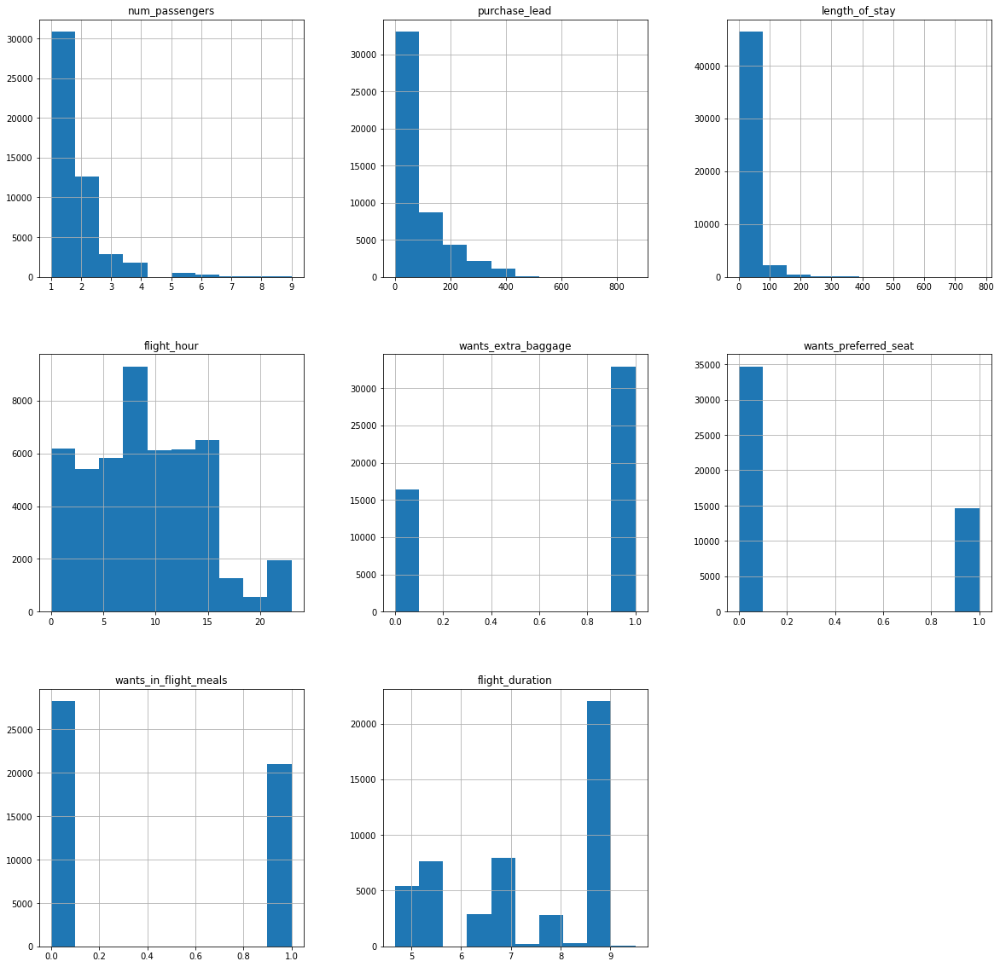

In [20]:
df[num_ftr].hist(figsize=(20,20))
plt.show()

#### 2. Exploring the distribution of the target variable

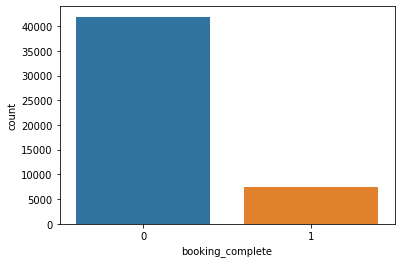

In [21]:
sns.countplot(data=pd.DataFrame(y), x='booking_complete')
plt.show()

We can clearly see that our target variable is unbalanced, which implies that we should use the "f-1" score as our evaluation metric. This will allow us to get a clear picture of our model's performance.
Using " accuracy" as a metric will lead to choosing the wrong model. The reason for this can be explained by the example of a dummy model that always predicts the most common class, this model will be considered a good model in an evaluation process where we use "accuracy" as a metric. 

### III. Tuning  and comparing the models.

In [22]:
# Splitting the data
train_X, test_X, train_y, test_y = train_test_split(df, y, test_size=0.30)
print(len(train_X), (len(train_y)))

34496 34496


#### 1. Tuning the models.

In [33]:
# A function to fit and tune Random Forest

def objective(trial):
    
    # Defining the scalers space 
    scalers = trial.suggest_categorical('scalers', ['minmax', 'standard', 'robust'])
    if scalers == 'minmax':
        scaler = MinMaxScaler()
    elif scalers == 'robust':
        scaler = RobustScaler()
    else:
        scaler = StandardScaler()
    
    # Defining the encoder space
    encoders = trial.suggest_categorical('encoders', ['Ordinal', 'OneHot', 'Count', 'Mean', 'PRatio'])
    if encoders == "Ordinal":
        encoder = OrdinalEncoder()
    elif encoders == 'OneHot':
        encoder = OneHotEncoder()
    elif encoders == "Count":
        encoder = CountFrequencyEncoder()
    elif encoders == 'Mean':
        encoder = MeanEncoder()
    else :
        encoder = PRatioEncoder()
        
    # The outliers trimmer:
    out_trimmer = trial.suggest_categorical('outlier_trimmer',[None, "Trimmer"])
    
    if out_trimmer == 'Timmer':
        out_trimmer = OutlierTrimmer(capping_method='iqr', tail='both', fold=1.5)
    else:
        out_trimmer = None
        
    # Defining the number of features for the second phase of feature selection using mutual inforamtion selector
    k = trial.suggest_int('k', low=2, high=len(train_X.columns))
    
    # Defining the n_estimators space
    n_estims = trial.suggest_int('n_estimators', low=20, high=600)
    
    # Defining the max_depth space
    max_dep = trial.suggest_int('max_depth', low=2, high=20)
        
    # Preprocessing steps for the numerical variables
    num_preproc = Pipeline(steps=[('scaler',scaler),
                                  ('trimmer', out_trimmer)])

    # Preprocessing steps for the categorical variables
    cat_preproc = Pipeline(steps=[('encoder', encoder)])

    preprocessor = ColumnTransformer(transformers=[('numerical_preprocessor',num_preproc, num_ftr),
                                               ('cat_preprocessor', cat_preproc, cat_ftr)])

    model_pipe = Pipeline(steps=[("preprocessing", preprocessor),
                                 ("selector", SelectKBest(mutual_info_classif, k=k)),
                                 ("model", RandomForestClassifier(n_estimators=n_estims, max_depth=max_dep, n_jobs=-1))])
    
    cv_score = cross_val_score(model_pipe, train_X, train_y, cv=2, scoring ='f1').mean()
    
    return cv_score

study_1 = optuna.create_study(direction='maximize')
study_1.optimize(objective, n_trials=300, show_progress_bar=True)

[I 2022-11-20 12:55:41,598] A new study created in memory with name: no-name-b024e4e5-3d4a-46bc-a419-23f9eb7cee37
Progress bar is experimental (supported from v1.2.0). The interface can change in the future.


  0%|          | 0/300 [00:00<?, ?it/s]

[I 2022-11-20 12:56:33,313] Trial 0 finished with value: 0.23976752321820732 and parameters: {'scalers': 'minmax', 'encoders': 'Ordinal', 'outlier_trimmer': None, 'k': 8, 'n_estimators': 173, 'max_depth': 18}. Best is trial 0 with value: 0.23976752321820732.
[I 2022-11-20 12:56:47,532] Trial 1 finished with value: 0.06386461926356521 and parameters: {'scalers': 'standard', 'encoders': 'Count', 'outlier_trimmer': None, 'k': 2, 'n_estimators': 132, 'max_depth': 15}. Best is trial 0 with value: 0.23976752321820732.
[I 2022-11-20 12:57:02,546] Trial 2 finished with value: 0.24064516193549915 and parameters: {'scalers': 'robust', 'encoders': 'Ordinal', 'outlier_trimmer': None, 'k': 5, 'n_estimators': 56, 'max_depth': 19}. Best is trial 2 with value: 0.24064516193549915.
[I 2022-11-20 12:57:27,779] Trial 3 finished with value: 0.0 and parameters: {'scalers': 'standard', 'encoders': 'Count', 'outlier_trimmer': 'Trimmer', 'k': 12, 'n_estimators': 265, 'max_depth': 5}. Best is trial 2 with valu

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

[I 2022-11-20 13:08:23,795] Trial 14 finished with value: 0.08193405889992282 and parameters: {'scalers': 'standard', 'encoders': 'OneHot', 'outlier_trimmer': None, 'k': 9, 'n_estimators': 37, 'max_depth': 11}. Best is trial 11 with value: 0.26959551218852096.
[I 2022-11-20 13:08:37,756] Trial 15 finished with value: 0.09999920303484333 and parameters: {'scalers': 'robust', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 2, 'n_estimators': 346, 'max_depth': 17}. Best is trial 11 with value: 0.26959551218852096.
[I 2022-11-20 13:08:50,515] Trial 16 finished with value: 0.1945800934254818 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 6, 'n_estimators': 229, 'max_depth': 13}. Best is trial 11 with value: 0.26959551218852096.
[I 2022-11-20 13:09:15,636] Trial 17 finished with value: 0.21123399070347534 and parameters: {'scalers': 'minmax', 'encoders': 'Mean', 'outlier_trimmer': None, 'k': 4, 'n_estimators': 490, 'max_depth': 20}. Best is tria

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

[I 2022-11-20 13:14:43,301] Trial 18 finished with value: 0.04292461633432391 and parameters: {'scalers': 'robust', 'encoders': 'OneHot', 'outlier_trimmer': None, 'k': 7, 'n_estimators': 405, 'max_depth': 17}. Best is trial 11 with value: 0.26959551218852096.
[I 2022-11-20 13:14:53,132] Trial 19 finished with value: 0.07171539371269836 and parameters: {'scalers': 'standard', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 4, 'n_estimators': 175, 'max_depth': 9}. Best is trial 11 with value: 0.26959551218852096.
[I 2022-11-20 13:15:13,183] Trial 20 finished with value: 0.20294929062316955 and parameters: {'scalers': 'robust', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 10, 'n_estimators': 294, 'max_depth': 18}. Best is trial 11 with value: 0.26959551218852096.
[I 2022-11-20 13:15:20,197] Trial 21 finished with value: 0.23575795944979033 and parameters: {'scalers': 'robust', 'encoders': 'Ordinal', 'outlier_trimmer': None, 'k': 5, 'n_estimators': 42, 'max_depth': 20}. Best is 

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

[I 2022-11-20 13:21:47,509] Trial 27 finished with value: 0.13643467468858053 and parameters: {'scalers': 'standard', 'encoders': 'OneHot', 'outlier_trimmer': None, 'k': 7, 'n_estimators': 533, 'max_depth': 20}. Best is trial 11 with value: 0.26959551218852096.
[I 2022-11-20 13:22:01,056] Trial 28 finished with value: 0.10195983756747387 and parameters: {'scalers': 'robust', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 3, 'n_estimators': 217, 'max_depth': 16}. Best is trial 11 with value: 0.26959551218852096.
[I 2022-11-20 13:22:13,826] Trial 29 finished with value: 0.24200606838604272 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 5, 'n_estimators': 172, 'max_depth': 18}. Best is trial 11 with value: 0.26959551218852096.
[I 2022-11-20 13:22:23,053] Trial 30 finished with value: 0.18208944227510498 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 8, 'n_estimators': 67, 'max_depth': 14}. Best is t

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

[I 2022-11-20 13:53:14,237] Trial 47 finished with value: 0.04385097263435542 and parameters: {'scalers': 'robust', 'encoders': 'OneHot', 'outlier_trimmer': None, 'k': 4, 'n_estimators': 261, 'max_depth': 17}. Best is trial 11 with value: 0.26959551218852096.
[I 2022-11-20 13:53:27,602] Trial 48 finished with value: 0.10234345435425957 and parameters: {'scalers': 'robust', 'encoders': 'Mean', 'outlier_trimmer': None, 'k': 3, 'n_estimators': 89, 'max_depth': 20}. Best is trial 11 with value: 0.26959551218852096.
[I 2022-11-20 13:53:46,983] Trial 49 finished with value: 0.05273059719937386 and parameters: {'scalers': 'minmax', 'encoders': 'Count', 'outlier_trimmer': None, 'k': 5, 'n_estimators': 350, 'max_depth': 10}. Best is trial 11 with value: 0.26959551218852096.
[I 2022-11-20 13:54:00,619] Trial 50 finished with value: 0.20953736083052177 and parameters: {'scalers': 'robust', 'encoders': 'Mean', 'outlier_trimmer': None, 'k': 9, 'n_estimators': 123, 'max_depth': 16}. Best is trial 11

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

[I 2022-11-20 14:01:04,885] Trial 57 finished with value: 0.04151347880570428 and parameters: {'scalers': 'minmax', 'encoders': 'OneHot', 'outlier_trimmer': None, 'k': 5, 'n_estimators': 435, 'max_depth': 12}. Best is trial 11 with value: 0.26959551218852096.
[I 2022-11-20 14:01:11,573] Trial 58 finished with value: 0.0 and parameters: {'scalers': 'standard', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 6, 'n_estimators': 85, 'max_depth': 2}. Best is trial 11 with value: 0.26959551218852096.
[I 2022-11-20 14:01:18,182] Trial 59 finished with value: 0.21318405357798173 and parameters: {'scalers': 'robust', 'encoders': 'Count', 'outlier_trimmer': None, 'k': 4, 'n_estimators': 37, 'max_depth': 17}. Best is trial 11 with value: 0.26959551218852096.
[I 2022-11-20 14:01:36,962] Trial 60 finished with value: 0.2420501969940172 and parameters: {'scalers': 'robust', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 5, 'n_estimators': 330, 'max_depth': 20}. Best is trial 11 with value: 

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

[I 2022-11-20 14:12:05,789] Trial 80 finished with value: 0.0003855050115651504 and parameters: {'scalers': 'robust', 'encoders': 'OneHot', 'outlier_trimmer': None, 'k': 3, 'n_estimators': 35, 'max_depth': 19}. Best is trial 11 with value: 0.26959551218852096.
[I 2022-11-20 14:12:17,193] Trial 81 finished with value: 0.24093603937206542 and parameters: {'scalers': 'robust', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 5, 'n_estimators': 62, 'max_depth': 20}. Best is trial 11 with value: 0.26959551218852096.
[I 2022-11-20 14:12:49,968] Trial 82 finished with value: 0.23764170527526673 and parameters: {'scalers': 'robust', 'encoders': 'Mean', 'outlier_trimmer': None, 'k': 5, 'n_estimators': 48, 'max_depth': 19}. Best is trial 11 with value: 0.26959551218852096.
[I 2022-11-20 14:14:11,560] Trial 83 finished with value: 0.24575059425397466 and parameters: {'scalers': 'robust', 'encoders': 'Mean', 'outlier_trimmer': None, 'k': 6, 'n_estimators': 481, 'max_depth': 20}. Best is trial 1

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

[I 2022-11-20 14:35:31,174] Trial 109 finished with value: 0.05678877560249021 and parameters: {'scalers': 'robust', 'encoders': 'OneHot', 'outlier_trimmer': None, 'k': 5, 'n_estimators': 66, 'max_depth': 19}. Best is trial 11 with value: 0.26959551218852096.
[I 2022-11-20 14:35:58,791] Trial 110 finished with value: 0.2212729514935599 and parameters: {'scalers': 'robust', 'encoders': 'Mean', 'outlier_trimmer': None, 'k': 6, 'n_estimators': 119, 'max_depth': 17}. Best is trial 11 with value: 0.26959551218852096.
[I 2022-11-20 14:36:17,532] Trial 111 finished with value: 0.25154931393629054 and parameters: {'scalers': 'robust', 'encoders': 'Mean', 'outlier_trimmer': None, 'k': 6, 'n_estimators': 32, 'max_depth': 19}. Best is trial 11 with value: 0.26959551218852096.
[I 2022-11-20 14:36:31,342] Trial 112 finished with value: 0.2555615301810238 and parameters: {'scalers': 'robust', 'encoders': 'Mean', 'outlier_trimmer': None, 'k': 6, 'n_estimators': 44, 'max_depth': 19}. Best is trial 11 

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

[I 2022-11-20 14:53:16,573] Trial 129 finished with value: 0.058263050565486085 and parameters: {'scalers': 'minmax', 'encoders': 'OneHot', 'outlier_trimmer': None, 'k': 6, 'n_estimators': 33, 'max_depth': 20}. Best is trial 11 with value: 0.26959551218852096.
[I 2022-11-20 14:53:38,125] Trial 130 finished with value: 0.24741353780853687 and parameters: {'scalers': 'standard', 'encoders': 'Mean', 'outlier_trimmer': None, 'k': 7, 'n_estimators': 72, 'max_depth': 19}. Best is trial 11 with value: 0.26959551218852096.
[I 2022-11-20 14:53:53,532] Trial 131 finished with value: 0.2440788127804619 and parameters: {'scalers': 'robust', 'encoders': 'Mean', 'outlier_trimmer': None, 'k': 5, 'n_estimators': 57, 'max_depth': 19}. Best is trial 11 with value: 0.26959551218852096.
[I 2022-11-20 14:54:25,648] Trial 132 finished with value: 0.24813894189827368 and parameters: {'scalers': 'robust', 'encoders': 'Mean', 'outlier_trimmer': None, 'k': 5, 'n_estimators': 46, 'max_depth': 20}. Best is trial 

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

[I 2022-11-20 15:14:08,579] Trial 165 finished with value: 0.1232435951085693 and parameters: {'scalers': 'robust', 'encoders': 'OneHot', 'outlier_trimmer': None, 'k': 6, 'n_estimators': 102, 'max_depth': 20}. Best is trial 11 with value: 0.26959551218852096.
[I 2022-11-20 15:14:21,647] Trial 166 finished with value: 0.2398198532267973 and parameters: {'scalers': 'robust', 'encoders': 'Mean', 'outlier_trimmer': None, 'k': 5, 'n_estimators': 36, 'max_depth': 19}. Best is trial 11 with value: 0.26959551218852096.
[I 2022-11-20 15:14:36,820] Trial 167 finished with value: 0.23767274926751597 and parameters: {'scalers': 'robust', 'encoders': 'Mean', 'outlier_trimmer': None, 'k': 6, 'n_estimators': 89, 'max_depth': 18}. Best is trial 11 with value: 0.26959551218852096.
[I 2022-11-20 15:14:48,071] Trial 168 finished with value: 0.24146049287178623 and parameters: {'scalers': 'robust', 'encoders': 'Mean', 'outlier_trimmer': None, 'k': 7, 'n_estimators': 54, 'max_depth': 20}. Best is trial 11 

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

[I 2022-11-20 15:31:17,792] Trial 197 finished with value: 0.10277861988778461 and parameters: {'scalers': 'robust', 'encoders': 'OneHot', 'outlier_trimmer': None, 'k': 6, 'n_estimators': 52, 'max_depth': 20}. Best is trial 11 with value: 0.26959551218852096.
[I 2022-11-20 15:31:28,090] Trial 198 finished with value: 0.23527305726853814 and parameters: {'scalers': 'robust', 'encoders': 'Mean', 'outlier_trimmer': None, 'k': 5, 'n_estimators': 20, 'max_depth': 19}. Best is trial 11 with value: 0.26959551218852096.
[I 2022-11-20 15:32:02,882] Trial 199 finished with value: 0.22670219015163728 and parameters: {'scalers': 'robust', 'encoders': 'Mean', 'outlier_trimmer': None, 'k': 6, 'n_estimators': 183, 'max_depth': 18}. Best is trial 11 with value: 0.26959551218852096.
[I 2022-11-20 15:32:16,890] Trial 200 finished with value: 0.2565170462454811 and parameters: {'scalers': 'minmax', 'encoders': 'Mean', 'outlier_trimmer': None, 'k': 6, 'n_estimators': 70, 'max_depth': 19}. Best is trial 11

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

[I 2022-11-20 15:47:55,321] Trial 245 finished with value: 0.12744117061577068 and parameters: {'scalers': 'minmax', 'encoders': 'OneHot', 'outlier_trimmer': None, 'k': 6, 'n_estimators': 54, 'max_depth': 20}. Best is trial 11 with value: 0.26959551218852096.
[I 2022-11-20 15:48:19,282] Trial 246 finished with value: 0.26841427366821413 and parameters: {'scalers': 'minmax', 'encoders': 'Mean', 'outlier_trimmer': None, 'k': 6, 'n_estimators': 447, 'max_depth': 19}. Best is trial 11 with value: 0.26959551218852096.
[I 2022-11-20 15:48:45,664] Trial 247 finished with value: 0.2578241237836265 and parameters: {'scalers': 'minmax', 'encoders': 'Mean', 'outlier_trimmer': None, 'k': 7, 'n_estimators': 468, 'max_depth': 20}. Best is trial 11 with value: 0.26959551218852096.
[I 2022-11-20 15:49:10,444] Trial 248 finished with value: 0.2604287961430819 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 7, 'n_estimators': 487, 'max_depth': 19}. Best is trial

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

[I 2022-11-20 16:41:05,702] Trial 286 finished with value: 0.11028337162899536 and parameters: {'scalers': 'minmax', 'encoders': 'OneHot', 'outlier_trimmer': None, 'k': 5, 'n_estimators': 535, 'max_depth': 19}. Best is trial 11 with value: 0.26959551218852096.
[I 2022-11-20 16:41:47,726] Trial 287 finished with value: 0.24964819906826824 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 5, 'n_estimators': 564, 'max_depth': 20}. Best is trial 11 with value: 0.26959551218852096.
[I 2022-11-20 16:42:26,187] Trial 288 finished with value: 0.22675420193150692 and parameters: {'scalers': 'standard', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 8, 'n_estimators': 524, 'max_depth': 18}. Best is trial 11 with value: 0.26959551218852096.
[I 2022-11-20 16:43:19,032] Trial 289 finished with value: 0.23825261111590845 and parameters: {'scalers': 'minmax', 'encoders': 'Ordinal', 'outlier_trimmer': None, 'k': 5, 'n_estimators': 503, 'max_depth': 20}. Bes

In [34]:
pickle.dump(study_1, open('optuna_study_3_BA.sav', 'wb'))

In [28]:
# Tuning the logistic regression model
def objective(trial):
    
    # Defining the scalers space 
    scalers = trial.suggest_categorical('scalers', ['minmax', 'standard', 'robust'])
    if scalers == 'minmax':
        scaler = MinMaxScaler()
    elif scalers == 'robust':
        scaler = RobustScaler()
    else:
        scaler = StandardScaler()
    
    # Defining the encoder space
    encoders = trial.suggest_categorical('encoders', ['Ordinal', 'OneHot', 'Count', 'Mean', 'PRatio'])
    if encoders == "Ordinal":
        encoder = OrdinalEncoder()
    elif encoders == 'OneHot':
        encoder = OneHotEncoder()
    elif encoders == "Count":
        encoder = CountFrequencyEncoder()
    elif encoders == 'Mean':
        encoder = MeanEncoder()
    else :
        encoder = PRatioEncoder()
        
    # The outliers trimmer:
    out_trimmer = trial.suggest_categorical('outlier_trimmer',[None, "Trimmer"])
    
    if out_trimmer == 'Timmer':
        out_trimmer = OutlierTrimmer(capping_method='iqr', tail='both', fold=1.5)
    else:
        out_trimmer = None
        
    # Defining the number of features for the second phase of feature selection using mutual inforamtion selector
    k = trial.suggest_int('k', low=2, high=len(train_X.columns))
        
    # Defining the "C" space 
    C = trial.suggest_loguniform('C', low=0.001, high=1)
    
    # numerical features preprocessor 
    num_prec = Pipeline(steps=[('scaler',scaler)])
    
    # categorical features preprocessor
    cat_prec = Pipeline(steps=[('encoder', encoder)])
    
    # Column transformer
    preprocessor = ColumnTransformer(transformers=[('numerical preprocessor', num_prec, num_ftr),
                                                  ('categorical preprocessor', cat_prec, cat_ftr)])
    
    log_model_pipe = Pipeline(steps=[('preprocessor', preprocessor),
                                    ("selector", SelectKBest(mutual_info_classif, k=k)),
                                    ('classifier', LogisticRegression(C=C, solver='saga'))])
    
    cv_score = cross_val_score(log_model_pipe, train_X, train_y, cv=5, scoring='f1').mean()
    return cv_score

study_2 = optuna.create_study(direction='maximize')
study_2.optimize(objective, n_trials=300, show_progress_bar=True)



[I 2022-11-19 14:39:51,091] A new study created in memory with name: no-name-8d1fe69e-8582-4413-ba92-c476379e0b73
Progress bar is experimental (supported from v1.2.0). The interface can change in the future.


  0%|          | 0/300 [00:00<?, ?it/s]

[I 2022-11-19 14:40:18,525] Trial 0 finished with value: 0.18307038784102142 and parameters: {'scalers': 'robust', 'encoders': 'PRatio', 'outlier_trimmer': 'Trimmer', 'k': 3, 'C': 0.4124591900204988}. Best is trial 0 with value: 0.18307038784102142.
[I 2022-11-19 14:40:47,458] Trial 1 finished with value: 0.15382128826337915 and parameters: {'scalers': 'standard', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 5, 'C': 0.046677140321282756}. Best is trial 0 with value: 0.18307038784102142.


The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 14:41:24,275] Trial 2 finished with value: 0.0 and parameters: {'scalers': 'minmax', 'encoders': 'Count', 'outlier_trimmer': 'Trimmer', 'k': 11, 'C': 0.0022767705130231513}. Best is trial 0 with value: 0.18307038784102142.
[I 2022-11-19 14:41:58,224] Trial 3 finished with value: 0.1866125803752982 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': 'Trimmer', 'k': 10, 'C': 0.21645462290911416}. Best is trial 3 with value: 0.1866125803752982.


DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

[I 2022-11-19 15:11:50,959] Trial 4 finished with value: 0.0 and parameters: {'scalers': 'standard', 'encoders': 'OneHot', 'outlier_trimmer': None, 'k': 12, 'C': 0.0017950464288411375}. Best is trial 3 with value: 0.1866125803752982.


The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 15:12:22,361] Trial 5 finished with value: 0.041117119081723566 and parameters: {'scalers': 'standard', 'encoders': 'Ordinal', 'outlier_trimmer': None, 'k': 6, 'C': 0.04703532417330929}. Best is trial 3 with value: 0.1866125803752982.
[I 2022-11-19 15:12:53,703] Trial 6 finished with value: 0.11984831537472589 and parameters: {'scalers': 'robust', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 9, 'C': 0.020093297574759184}. Best is trial 3 with value: 0.1866125803752982.


The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 15:13:20,164] Trial 7 finished with value: 0.0 and parameters: {'scalers': 'robust', 'encoders': 'Ordinal', 'outlier_trimmer': None, 'k': 2, 'C': 0.7600569498916723}. Best is trial 3 with value: 0.1866125803752982.
[I 2022-11-19 15:13:42,175] Trial 8 finished with value: 0.0 and parameters: {'scalers': 'standard', 'encoders': 'Mean', 'outlier_trimmer': None, 'k': 12, 'C': 0.0017115911884508937}. Best is trial 3 with value: 0.1866125803752982.


The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 15:14:23,713] Trial 9 finished with value: 0.0003827751196172249 and parameters: {'scalers': 'minmax', 'encoders': 'Count', 'outlier_trimmer': 'Trimmer', 'k': 9, 'C': 0.5162582155281988}. Best is trial 3 with value: 0.1866125803752982.


DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

[I 2022-11-19 15:41:44,058] Trial 10 finished with value: 0.0108499095840868 and parameters: {'scalers': 'minmax', 'encoders': 'OneHot', 'outlier_trimmer': None, 'k': 9, 'C': 0.1478613440076689}. Best is trial 3 with value: 0.1866125803752982.
[I 2022-11-19 15:42:15,094] Trial 11 finished with value: 0.18318060529168728 and parameters: {'scalers': 'robust', 'encoders': 'PRatio', 'outlier_trimmer': 'Trimmer', 'k': 2, 'C': 0.1980763461588927}. Best is trial 3 with value: 0.1866125803752982.
[I 2022-11-19 15:42:58,052] Trial 12 finished with value: 0.1914550938342773 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 7, 'C': 0.20281009847723172}. Best is trial 12 with value: 0.1914550938342773.
[I 2022-11-19 15:43:32,354] Trial 13 finished with value: 0.1819852493309939 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 7, 'C': 0.1316341612402503}. Best is trial 12 with value: 0.1914550938342773.
[I 2022-11-19 1

The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 15:46:16,132] Trial 18 finished with value: 0.02148836637667099 and parameters: {'scalers': 'minmax', 'encoders': 'Ordinal', 'outlier_trimmer': None, 'k': 7, 'C': 0.39023868410451684}. Best is trial 12 with value: 0.1914550938342773.
[I 2022-11-19 15:46:56,597] Trial 19 finished with value: 0.08369249977227608 and parameters: {'scalers': 'minmax', 'encoders': 'Mean', 'outlier_trimmer': None, 'k': 4, 'C': 0.06807696479103913}. Best is trial 12 with value: 0.1914550938342773.


DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

[I 2022-11-19 16:11:46,794] Trial 20 finished with value: 0.01575094634186248 and parameters: {'scalers': 'minmax', 'encoders': 'OneHot', 'outlier_trimmer': None, 'k': 8, 'C': 0.2625177412002867}. Best is trial 12 with value: 0.1914550938342773.
[I 2022-11-19 16:12:38,333] Trial 21 finished with value: 0.19460853281706164 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 13, 'C': 0.7045074586000721}. Best is trial 21 with value: 0.19460853281706164.
[I 2022-11-19 16:13:24,646] Trial 22 finished with value: 0.19469587359434554 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 13, 'C': 0.8334764138748942}. Best is trial 22 with value: 0.19469587359434554.
[I 2022-11-19 16:14:11,962] Trial 23 finished with value: 0.1898133606188044 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 11, 'C': 0.939357326879964}. Best is trial 22 with value: 0.19469587359434554.
[I 2022-11-1

The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 16:15:54,303] Trial 25 finished with value: 0.0 and parameters: {'scalers': 'minmax', 'encoders': 'Count', 'outlier_trimmer': None, 'k': 13, 'C': 0.6795621894761815}. Best is trial 22 with value: 0.19469587359434554.


The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 16:16:42,384] Trial 26 finished with value: 0.19333716550385827 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.97809413841051}. Best is trial 22 with value: 0.19469587359434554.


The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 16:17:36,916] Trial 27 finished with value: 0.19135646407749105 and parameters: {'scalers': 'robust', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 11, 'C': 0.5773988278165955}. Best is trial 22 with value: 0.19469587359434554.
[I 2022-11-19 16:18:16,217] Trial 28 finished with value: 0.0076673081220462996 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 13, 'C': 0.0046171684093744576}. Best is trial 22 with value: 0.19469587359434554.


The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 16:19:16,046] Trial 29 finished with value: 0.19118941870287204 and parameters: {'scalers': 'standard', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.4079916966604075}. Best is trial 22 with value: 0.19469587359434554.


DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

[I 2022-11-19 16:52:31,303] Trial 30 finished with value: 0.02103356216628528 and parameters: {'scalers': 'robust', 'encoders': 'OneHot', 'outlier_trimmer': None, 'k': 10, 'C': 0.10731293387121557}. Best is trial 22 with value: 0.19469587359434554.


The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 16:52:56,656] Trial 31 finished with value: 0.19622294982997207 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.9742065730018205}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-19 16:53:19,678] Trial 32 finished with value: 0.1928652672199344 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 13, 'C': 0.45072092818974474}. Best is trial 31 with value: 0.19622294982997207.


The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 16:53:45,312] Trial 33 finished with value: 0.19466231623993918 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.9616615167181768}. Best is trial 31 with value: 0.19622294982997207.


The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 16:54:13,119] Trial 34 finished with value: 0.0007648190546697559 and parameters: {'scalers': 'minmax', 'encoders': 'Count', 'outlier_trimmer': None, 'k': 11, 'C': 0.9526441212432091}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-19 16:54:35,094] Trial 35 finished with value: 0.18816624495069073 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.3033112184384557}. Best is trial 31 with value: 0.19622294982997207.


The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 16:55:05,151] Trial 36 finished with value: 0.19226807467775114 and parameters: {'scalers': 'standard', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.5822264098387714}. Best is trial 31 with value: 0.19622294982997207.


The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 16:55:33,702] Trial 37 finished with value: 0.0038244856514284935 and parameters: {'scalers': 'minmax', 'encoders': 'Ordinal', 'outlier_trimmer': None, 'k': 11, 'C': 0.0011236898691128654}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-19 16:55:54,780] Trial 38 finished with value: 0.15623163395068881 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 10, 'C': 0.03426002693573948}. Best is trial 31 with value: 0.19622294982997207.


The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 16:56:23,072] Trial 39 finished with value: 0.1753752431046891 and parameters: {'scalers': 'standard', 'encoders': 'Mean', 'outlier_trimmer': None, 'k': 11, 'C': 0.36713958834107735}. Best is trial 31 with value: 0.19622294982997207.


The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 16:56:51,931] Trial 40 finished with value: 0.00037950664136622385 and parameters: {'scalers': 'robust', 'encoders': 'Count', 'outlier_trimmer': None, 'k': 12, 'C': 0.8175091760968084}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-19 16:57:16,205] Trial 41 finished with value: 0.1946083306394349 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 13, 'C': 0.6548998045623089}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-19 16:57:39,960] Trial 42 finished with value: 0.19318065507164586 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 13, 'C': 0.505428788037396}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-19 16:58:04,078] Trial 43 finished with value: 0.19455726913513324 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.6859108911837567}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-

The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 16:58:54,821] Trial 45 finished with value: 0.027982472276846516 and parameters: {'scalers': 'minmax', 'encoders': 'Ordinal', 'outlier_trimmer': None, 'k': 12, 'C': 0.957759579742424}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-19 16:59:15,739] Trial 46 finished with value: 0.1829272868542569 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 10, 'C': 0.15325891409416545}. Best is trial 31 with value: 0.19622294982997207.


DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

[I 2022-11-19 17:20:38,324] Trial 47 finished with value: 0.026429603884577196 and parameters: {'scalers': 'standard', 'encoders': 'OneHot', 'outlier_trimmer': None, 'k': 13, 'C': 0.5073471994190308}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-19 17:21:19,012] Trial 48 finished with value: 0.19203780184750235 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.2963340737206391}. Best is trial 31 with value: 0.19622294982997207.


The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 17:21:57,109] Trial 49 finished with value: 0.18726217396941716 and parameters: {'scalers': 'robust', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 9, 'C': 0.7405996470625067}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-19 17:22:24,374] Trial 50 finished with value: 0.17434610509847487 and parameters: {'scalers': 'minmax', 'encoders': 'Mean', 'outlier_trimmer': None, 'k': 11, 'C': 0.3706619289881212}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-19 17:22:57,114] Trial 51 finished with value: 0.19484130047113477 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 13, 'C': 0.7364051555924181}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-19 17:23:29,407] Trial 52 finished with value: 0.1945784112334409 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 13, 'C': 0.7202175965239666}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-1

The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 17:26:09,989] Trial 57 finished with value: 0.021473119967938558 and parameters: {'scalers': 'minmax', 'encoders': 'Ordinal', 'outlier_trimmer': None, 'k': 11, 'C': 0.015520699509421662}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-19 17:26:40,318] Trial 58 finished with value: 0.19122450711910405 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 13, 'C': 0.35115631772083317}. Best is trial 31 with value: 0.19622294982997207.


The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 17:27:15,106] Trial 59 finished with value: 0.000761550576418755 and parameters: {'scalers': 'minmax', 'encoders': 'Count', 'outlier_trimmer': None, 'k': 8, 'C': 0.16912897685688036}. Best is trial 31 with value: 0.19622294982997207.


DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

[I 2022-11-19 17:49:36,261] Trial 60 finished with value: 0.03158684075186223 and parameters: {'scalers': 'minmax', 'encoders': 'OneHot', 'outlier_trimmer': None, 'k': 11, 'C': 0.8066902569790826}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-19 17:50:13,628] Trial 61 finished with value: 0.19404095141190664 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 13, 'C': 0.5928061400367998}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-19 17:50:52,172] Trial 62 finished with value: 0.1933946689343748 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 13, 'C': 0.5291761778634324}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-19 17:51:32,788] Trial 63 finished with value: 0.19348777972948458 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.7420439541558553}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-1

The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 17:53:26,929] Trial 66 finished with value: 0.18654044992546412 and parameters: {'scalers': 'robust', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.24266525693559463}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-19 17:54:15,981] Trial 67 finished with value: 0.1661429387312586 and parameters: {'scalers': 'standard', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 13, 'C': 0.05343613630828057}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-19 17:54:46,829] Trial 68 finished with value: 0.1868156794640538 and parameters: {'scalers': 'minmax', 'encoders': 'Mean', 'outlier_trimmer': None, 'k': 13, 'C': 0.7911862658500239}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-19 17:55:20,240] Trial 69 finished with value: 0.039034858376712875 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 11, 'C': 0.008159979442371339}. Best is trial 31 with value: 0.19622294982997207.
[I 20

The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 17:59:52,149] Trial 76 finished with value: 0.0 and parameters: {'scalers': 'minmax', 'encoders': 'Count', 'outlier_trimmer': None, 'k': 13, 'C': 0.6279532031462376}. Best is trial 31 with value: 0.19622294982997207.


The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 18:00:37,127] Trial 77 finished with value: 0.07459190426292191 and parameters: {'scalers': 'standard', 'encoders': 'Ordinal', 'outlier_trimmer': None, 'k': 12, 'C': 0.9867173018295573}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-19 18:01:15,778] Trial 78 finished with value: 0.19171453650944176 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 11, 'C': 0.45701751986405154}. Best is trial 31 with value: 0.19622294982997207.


DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

[I 2022-11-19 18:28:24,542] Trial 79 finished with value: 0.0108499095840868 and parameters: {'scalers': 'robust', 'encoders': 'OneHot', 'outlier_trimmer': None, 'k': 13, 'C': 0.6868947713643138}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-19 18:28:51,197] Trial 80 finished with value: 0.004232999548975073 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 10, 'C': 0.0027250192829017506}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-19 18:29:20,173] Trial 81 finished with value: 0.19469587359434554 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 13, 'C': 0.8075285820521347}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-19 18:29:49,735] Trial 82 finished with value: 0.19469587359434554 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 13, 'C': 0.8217224261579387}. Best is trial 31 with value: 0.19622294982997207.
[I 20

The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 18:32:12,083] Trial 87 finished with value: 0.19301644211701968 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.978365109964888}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-19 18:32:40,827] Trial 88 finished with value: 0.19484130047113477 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 13, 'C': 0.7338194967027108}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-19 18:33:07,502] Trial 89 finished with value: 0.18934079357727965 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 13, 'C': 0.3033300249679399}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-19 18:33:33,404] Trial 90 finished with value: 0.14749369540828347 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.029271324527542664}. Best is trial 31 with value: 0.19622294982997207.
[I 2022

The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 18:37:18,623] Trial 98 finished with value: 0.07397853949810691 and parameters: {'scalers': 'standard', 'encoders': 'Ordinal', 'outlier_trimmer': None, 'k': 13, 'C': 0.38385783353004427}. Best is trial 31 with value: 0.19622294982997207.


The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 18:37:49,690] Trial 99 finished with value: 0.0 and parameters: {'scalers': 'robust', 'encoders': 'Count', 'outlier_trimmer': None, 'k': 13, 'C': 0.5406387507867535}. Best is trial 31 with value: 0.19622294982997207.


DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

[I 2022-11-19 19:03:12,593] Trial 100 finished with value: 0.001157928833917262 and parameters: {'scalers': 'minmax', 'encoders': 'OneHot', 'outlier_trimmer': None, 'k': 13, 'C': 0.8671843664400907}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-19 19:04:03,001] Trial 101 finished with value: 0.1945784112334409 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 13, 'C': 0.7215635530427157}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-19 19:04:50,248] Trial 102 finished with value: 0.1948130421487142 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 13, 'C': 0.7626899780446088}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-19 19:05:37,502] Trial 103 finished with value: 0.1946083306394349 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 13, 'C': 0.6253434465968009}. Best is trial 31 with value: 0.19622294982997207.
[I 202

The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 19:07:18,373] Trial 105 finished with value: 0.1937695366133116 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 13, 'C': 0.9876365854453796}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-19 19:08:32,837] Trial 106 finished with value: 0.1945044070976453 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.8585980863686762}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-19 19:09:45,863] Trial 107 finished with value: 0.1933946689343748 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 13, 'C': 0.5340560997068887}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-19 19:10:41,238] Trial 108 finished with value: 0.19460853281706164 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 13, 'C': 0.7059101811398923}. Best is trial 31 with value: 0.19622294982997207.
[I 2022

The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 19:21:15,035] Trial 119 finished with value: 0.19417814826942825 and parameters: {'scalers': 'standard', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.9869979310887176}. Best is trial 31 with value: 0.19622294982997207.


The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 19:22:03,817] Trial 120 finished with value: 0.1902465549456235 and parameters: {'scalers': 'robust', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 13, 'C': 0.33601403728249996}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-19 19:22:53,232] Trial 121 finished with value: 0.19469587359434554 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 13, 'C': 0.7840187796325871}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-19 19:23:32,504] Trial 122 finished with value: 0.1948130421487142 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 13, 'C': 0.7620091392799735}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-19 19:24:19,848] Trial 123 finished with value: 0.1946083306394349 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 13, 'C': 0.6204330099599858}. Best is trial 31 with value: 0.19622294982997207.
[I 202

The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 19:27:00,909] Trial 126 finished with value: 0.0 and parameters: {'scalers': 'minmax', 'encoders': 'Count', 'outlier_trimmer': None, 'k': 12, 'C': 0.08076249385310814}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-19 19:28:01,103] Trial 127 finished with value: 0.19472437499091397 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 13, 'C': 0.8839613883033292}. Best is trial 31 with value: 0.19622294982997207.


The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 19:28:53,477] Trial 128 finished with value: 0.02796970314321091 and parameters: {'scalers': 'minmax', 'encoders': 'Ordinal', 'outlier_trimmer': None, 'k': 13, 'C': 0.9963513075891102}. Best is trial 31 with value: 0.19622294982997207.


DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

[I 2022-11-19 20:00:37,895] Trial 129 finished with value: 0.022294988704460596 and parameters: {'scalers': 'minmax', 'encoders': 'OneHot', 'outlier_trimmer': None, 'k': 12, 'C': 0.5758114350859528}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-19 20:01:07,576] Trial 130 finished with value: 0.18977351829127853 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.4826056395436519}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-19 20:01:35,923] Trial 131 finished with value: 0.19460853281706164 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 13, 'C': 0.7096725274927214}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-19 20:02:12,262] Trial 132 finished with value: 0.19469587359434554 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 13, 'C': 0.8475743128743662}. Best is trial 31 with value: 0.19622294982997207.
[I 

The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 20:09:11,592] Trial 145 finished with value: 0.19592479003888502 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.9998679966805276}. Best is trial 31 with value: 0.19622294982997207.


The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 20:09:42,282] Trial 146 finished with value: 0.1952155669181121 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.9637543243766032}. Best is trial 31 with value: 0.19622294982997207.


The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 20:10:15,017] Trial 147 finished with value: 0.1938821637298978 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.9825309897871859}. Best is trial 31 with value: 0.19622294982997207.


The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 20:10:50,228] Trial 148 finished with value: 0.1916833856095908 and parameters: {'scalers': 'standard', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.7404826764777268}. Best is trial 31 with value: 0.19622294982997207.


The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 20:11:26,499] Trial 149 finished with value: 0.1908422172825141 and parameters: {'scalers': 'robust', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 11, 'C': 0.9958169541527034}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-19 20:11:56,993] Trial 150 finished with value: 0.18966218545853367 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.6473153374096503}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-19 20:12:33,305] Trial 151 finished with value: 0.1948130421487142 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 13, 'C': 0.7516553380692766}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-19 20:13:04,531] Trial 152 finished with value: 0.19393351259579097 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.7439711004889585}. Best is trial 31 with value: 0.19622294982997207.
[I 202

The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 20:15:51,125] Trial 157 finished with value: 0.0 and parameters: {'scalers': 'minmax', 'encoders': 'Count', 'outlier_trimmer': None, 'k': 12, 'C': 0.00461435859825748}. Best is trial 31 with value: 0.19622294982997207.


The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 20:16:26,413] Trial 158 finished with value: 0.02795264257820514 and parameters: {'scalers': 'minmax', 'encoders': 'Ordinal', 'outlier_trimmer': None, 'k': 13, 'C': 0.6197955099575285}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-19 20:16:55,465] Trial 159 finished with value: 0.1929167136898107 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.7449119562278111}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-19 20:17:28,925] Trial 160 finished with value: 0.19463675876703657 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 13, 'C': 0.6808134167409178}. Best is trial 31 with value: 0.19622294982997207.


The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 20:17:59,529] Trial 161 finished with value: 0.19385781215800868 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 13, 'C': 0.9964967746494787}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-19 20:18:28,318] Trial 162 finished with value: 0.19472437499091397 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 13, 'C': 0.8610122758306464}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-19 20:18:56,629] Trial 163 finished with value: 0.19469587359434554 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 13, 'C': 0.7911436533486115}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-19 20:19:23,207] Trial 164 finished with value: 0.1934315147207603 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 13, 'C': 0.57140761337088}. Best is trial 31 with value: 0.19622294982997207.


DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

[I 2022-11-19 20:38:15,716] Trial 165 finished with value: 0.014612437873943767 and parameters: {'scalers': 'minmax', 'encoders': 'OneHot', 'outlier_trimmer': None, 'k': 13, 'C': 0.8645673387247323}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-19 20:38:42,378] Trial 166 finished with value: 0.1948413740770489 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 13, 'C': 0.7259383030632264}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-19 20:39:10,124] Trial 167 finished with value: 0.19278253441701068 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.6597808834600785}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-19 20:39:37,380] Trial 168 finished with value: 0.1948130421487142 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 13, 'C': 0.7483587848378167}. Best is trial 31 with value: 0.19622294982997207.
[I 20

The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 20:44:09,139] Trial 178 finished with value: 0.19167490533043813 and parameters: {'scalers': 'standard', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.7816300478360976}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-19 20:44:34,843] Trial 179 finished with value: 0.19307015460901336 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 11, 'C': 0.5198973560777997}. Best is trial 31 with value: 0.19622294982997207.


The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 20:45:06,808] Trial 180 finished with value: 0.19280488143139332 and parameters: {'scalers': 'robust', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.6925268080174484}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-19 20:45:34,205] Trial 181 finished with value: 0.1948130421487142 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 13, 'C': 0.7656853498424087}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-19 20:46:03,835] Trial 182 finished with value: 0.19469587359434554 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 13, 'C': 0.8391399264145253}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-19 20:46:27,305] Trial 183 finished with value: 0.14386536742907602 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 13, 'C': 0.025916237837041715}. Best is trial 31 with value: 0.19622294982997207.
[I 

The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 20:49:35,847] Trial 190 finished with value: 0.19463610054552277 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.9912902814354142}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-19 20:50:04,230] Trial 191 finished with value: 0.19508598387869697 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.7651162161511914}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-19 20:50:27,608] Trial 192 finished with value: 0.16166711931607183 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.04118250907307015}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-19 20:50:55,874] Trial 193 finished with value: 0.1946854417938159 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.8623903027693045}. Best is trial 31 with value: 0.19622294982997207.
[I 2

The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 20:52:25,038] Trial 196 finished with value: 0.0 and parameters: {'scalers': 'minmax', 'encoders': 'Count', 'outlier_trimmer': None, 'k': 12, 'C': 0.7593458374470377}. Best is trial 31 with value: 0.19622294982997207.


The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 20:52:56,965] Trial 197 finished with value: 0.027346689657815327 and parameters: {'scalers': 'minmax', 'encoders': 'Ordinal', 'outlier_trimmer': None, 'k': 12, 'C': 0.8328679645403446}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-19 20:53:24,379] Trial 198 finished with value: 0.1927794680832577 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.5007729271374394}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-19 20:53:51,368] Trial 199 finished with value: 0.19415457111758316 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.7184861050498678}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-19 20:54:17,350] Trial 200 finished with value: 0.18607739230384407 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 7, 'C': 0.9015419682985751}. Best is trial 31 with value: 0.19622294982997207.
[I 2

The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 20:55:45,992] Trial 203 finished with value: 0.1937695366133116 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 13, 'C': 0.9870897984765591}. Best is trial 31 with value: 0.19622294982997207.


DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

[I 2022-11-19 21:14:37,778] Trial 204 finished with value: 0.002672596807843626 and parameters: {'scalers': 'minmax', 'encoders': 'OneHot', 'outlier_trimmer': None, 'k': 12, 'C': 0.7910534373578249}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-19 21:15:08,747] Trial 205 finished with value: 0.1934315147207603 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 13, 'C': 0.5694167297020416}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-19 21:15:36,417] Trial 206 finished with value: 0.19463675876703657 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 13, 'C': 0.6804746578886763}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-19 21:16:04,898] Trial 207 finished with value: 0.19472437499091397 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 13, 'C': 0.8801448985992093}. Best is trial 31 with value: 0.19622294982997207.
[I 2

The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 21:18:53,085] Trial 213 finished with value: 0.19385781215800868 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 13, 'C': 0.9990619713241138}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-19 21:19:21,739] Trial 214 finished with value: 0.19466688035065732 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 13, 'C': 0.687394205499842}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-19 21:19:44,217] Trial 215 finished with value: 0.1896768949886985 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 3, 'C': 0.8811174193692254}. Best is trial 31 with value: 0.19622294982997207.


The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 21:20:18,010] Trial 216 finished with value: 0.19379872166823534 and parameters: {'scalers': 'standard', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 13, 'C': 0.782194356907104}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-19 21:20:42,195] Trial 217 finished with value: 0.18479563654641126 and parameters: {'scalers': 'minmax', 'encoders': 'Mean', 'outlier_trimmer': None, 'k': 13, 'C': 0.6475828076010615}. Best is trial 31 with value: 0.19622294982997207.


The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 21:21:15,548] Trial 218 finished with value: 0.19169075959637588 and parameters: {'scalers': 'robust', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 13, 'C': 0.5460693235221644}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-19 21:21:44,617] Trial 219 finished with value: 0.19472437499091397 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 13, 'C': 0.8812393268702363}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-19 21:22:12,427] Trial 220 finished with value: 0.1947939457747792 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.7256974527207563}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-19 21:22:40,268] Trial 221 finished with value: 0.19475457867297846 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 13, 'C': 0.776767676457634}. Best is trial 31 with value: 0.19622294982997207.
[I 202

The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 21:26:21,011] Trial 229 finished with value: 0.1957773109410978 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.9907470948950711}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-19 21:26:46,325] Trial 230 finished with value: 0.1918423651655057 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 8, 'C': 0.9740307853083321}. Best is trial 31 with value: 0.19622294982997207.


The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 21:27:15,125] Trial 231 finished with value: 0.19581818699552003 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.9965497974677935}. Best is trial 31 with value: 0.19622294982997207.


The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 21:27:43,313] Trial 232 finished with value: 0.1919576084225047 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.9193828051821161}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-19 21:28:12,347] Trial 233 finished with value: 0.19556428213061616 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.8728946564192746}. Best is trial 31 with value: 0.19622294982997207.


The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 21:28:40,392] Trial 234 finished with value: 0.19224414237894086 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.9939951361407258}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-19 21:29:08,635] Trial 235 finished with value: 0.19424024468159123 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.8720398783656921}. Best is trial 31 with value: 0.19622294982997207.
[I 2022-11-19 21:29:37,346] Trial 236 finished with value: 0.1964891476697317 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.8352769818996103}. Best is trial 236 with value: 0.1964891476697317.


The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 21:30:05,998] Trial 237 finished with value: 0.1933047616543637 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.9934214873193132}. Best is trial 236 with value: 0.1964891476697317.
[I 2022-11-19 21:30:33,637] Trial 238 finished with value: 0.19536966561043007 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.8485393635356064}. Best is trial 236 with value: 0.1964891476697317.


The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 21:31:06,103] Trial 239 finished with value: 0.0 and parameters: {'scalers': 'minmax', 'encoders': 'Count', 'outlier_trimmer': None, 'k': 11, 'C': 0.8349106041555817}. Best is trial 236 with value: 0.1964891476697317.


The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 21:31:37,843] Trial 240 finished with value: 0.028360465236539935 and parameters: {'scalers': 'minmax', 'encoders': 'Ordinal', 'outlier_trimmer': None, 'k': 12, 'C': 0.8779333371538001}. Best is trial 236 with value: 0.1964891476697317.
[I 2022-11-19 21:32:05,246] Trial 241 finished with value: 0.19309724755715169 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.6631656549308936}. Best is trial 236 with value: 0.1964891476697317.
[I 2022-11-19 21:32:32,748] Trial 242 finished with value: 0.19422819649244794 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.7887071221795607}. Best is trial 236 with value: 0.1964891476697317.
[I 2022-11-19 21:32:56,724] Trial 243 finished with value: 0.003077671968171685 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.001307714794857459}. Best is trial 236 with value: 0.1964891476697317.

The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 21:34:20,296] Trial 246 finished with value: 0.1964511894412113 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.9974545453137952}. Best is trial 236 with value: 0.1964891476697317.


The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 21:34:45,404] Trial 247 finished with value: 0.19595458344040062 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.9698850406254225}. Best is trial 236 with value: 0.1964891476697317.


The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 21:35:12,540] Trial 248 finished with value: 0.19629769879920259 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.9735550149874942}. Best is trial 236 with value: 0.1964891476697317.


The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 21:35:40,940] Trial 249 finished with value: 0.19203066261540627 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 11, 'C': 0.9907207215488553}. Best is trial 236 with value: 0.1964891476697317.


DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

[I 2022-11-19 21:55:39,348] Trial 250 finished with value: 0.03490688372231323 and parameters: {'scalers': 'minmax', 'encoders': 'OneHot', 'outlier_trimmer': None, 'k': 12, 'C': 0.914755357218763}. Best is trial 236 with value: 0.1964891476697317.


The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 21:56:07,804] Trial 251 finished with value: 0.19442429697518904 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.9841144182675566}. Best is trial 236 with value: 0.1964891476697317.


The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 21:56:36,133] Trial 252 finished with value: 0.196232271012006 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.9967720114890503}. Best is trial 236 with value: 0.1964891476697317.


The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 21:57:04,452] Trial 253 finished with value: 0.19474123010296823 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.9929525679611282}. Best is trial 236 with value: 0.1964891476697317.


The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 21:57:39,397] Trial 254 finished with value: 0.18873693044306677 and parameters: {'scalers': 'standard', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.8665201231105082}. Best is trial 236 with value: 0.1964891476697317.
[I 2022-11-19 21:58:07,281] Trial 255 finished with value: 0.19496400175853168 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.8391452165874188}. Best is trial 236 with value: 0.1964891476697317.


The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 21:58:35,897] Trial 256 finished with value: 0.16843140800208353 and parameters: {'scalers': 'robust', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.06070591139323404}. Best is trial 236 with value: 0.1964891476697317.


The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 21:59:04,309] Trial 257 finished with value: 0.19668378440784587 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.9888924909525354}. Best is trial 257 with value: 0.19668378440784587.
[I 2022-11-19 21:59:25,685] Trial 258 finished with value: 0.1902427126665175 and parameters: {'scalers': 'minmax', 'encoders': 'Mean', 'outlier_trimmer': None, 'k': 12, 'C': 0.9803158431663103}. Best is trial 257 with value: 0.19668378440784587.


The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 21:59:51,049] Trial 259 finished with value: 0.19652369711495452 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.9954789395009207}. Best is trial 257 with value: 0.19668378440784587.


The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 22:00:15,483] Trial 260 finished with value: 0.19529178759319374 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.9949589831136091}. Best is trial 257 with value: 0.19668378440784587.


The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 22:00:39,731] Trial 261 finished with value: 0.19445209715278589 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 11, 'C': 0.9791312983219543}. Best is trial 257 with value: 0.19668378440784587.


The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 22:01:04,865] Trial 262 finished with value: 0.19237846816276655 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.9917085130086376}. Best is trial 257 with value: 0.19668378440784587.
[I 2022-11-19 22:01:29,969] Trial 263 finished with value: 0.19494696891768387 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.8490678318675852}. Best is trial 257 with value: 0.19668378440784587.
[I 2022-11-19 22:01:54,757] Trial 264 finished with value: 0.1945245496912164 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.8882067532399185}. Best is trial 257 with value: 0.19668378440784587.


The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 22:02:19,197] Trial 265 finished with value: 0.1934828436225506 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.9975785235897089}. Best is trial 257 with value: 0.19668378440784587.
[I 2022-11-19 22:02:43,377] Trial 266 finished with value: 0.19327167421708957 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.8757880106143203}. Best is trial 257 with value: 0.19668378440784587.
[I 2022-11-19 22:03:08,940] Trial 267 finished with value: 0.19567473218224146 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.8634378274826214}. Best is trial 257 with value: 0.19668378440784587.
[I 2022-11-19 22:03:32,854] Trial 268 finished with value: 0.19139535044557077 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 11, 'C': 0.8800595684101536}. Best is trial 257 with value: 0.19668378440784587.
[

The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 22:05:11,402] Trial 272 finished with value: 0.19264436556789394 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.9903807576108119}. Best is trial 257 with value: 0.19668378440784587.


The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 22:05:38,904] Trial 273 finished with value: 0.0003827751196172249 and parameters: {'scalers': 'minmax', 'encoders': 'Count', 'outlier_trimmer': None, 'k': 12, 'C': 0.9937256379586408}. Best is trial 257 with value: 0.19668378440784587.


The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 22:06:11,253] Trial 274 finished with value: 0.026134957358446842 and parameters: {'scalers': 'minmax', 'encoders': 'Ordinal', 'outlier_trimmer': None, 'k': 12, 'C': 0.8360955251235835}. Best is trial 257 with value: 0.19668378440784587.
[I 2022-11-19 22:06:34,817] Trial 275 finished with value: 0.19418775760838575 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 11, 'C': 0.8422167458798766}. Best is trial 257 with value: 0.19668378440784587.
[I 2022-11-19 22:06:59,202] Trial 276 finished with value: 0.19125383966154627 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.8528700408978594}. Best is trial 257 with value: 0.19668378440784587.
[I 2022-11-19 22:07:23,509] Trial 277 finished with value: 0.19451601042856886 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 11, 'C': 0.8623431527479933}. Best is trial 257 with value: 0.19668378440784587

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

[I 2022-11-19 22:28:22,526] Trial 278 finished with value: 0.009485281459803754 and parameters: {'scalers': 'minmax', 'encoders': 'OneHot', 'outlier_trimmer': None, 'k': 12, 'C': 0.9868602571693289}. Best is trial 257 with value: 0.19668378440784587.


The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 22:28:54,958] Trial 279 finished with value: 0.1934798349027202 and parameters: {'scalers': 'standard', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.9988200379607861}. Best is trial 257 with value: 0.19668378440784587.
[I 2022-11-19 22:29:22,737] Trial 280 finished with value: 0.19193461235970227 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.853301454099714}. Best is trial 257 with value: 0.19668378440784587.


The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge
The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 22:29:55,568] Trial 281 finished with value: 0.1835573187034229 and parameters: {'scalers': 'robust', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.13336891434146472}. Best is trial 257 with value: 0.19668378440784587.
[I 2022-11-19 22:30:19,104] Trial 282 finished with value: 0.005000014203518286 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.0032298382212822435}. Best is trial 257 with value: 0.19668378440784587.
[I 2022-11-19 22:30:48,919] Trial 283 finished with value: 0.1946625822378528 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.8271547123296743}. Best is trial 257 with value: 0.19668378440784587.


The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 22:31:18,468] Trial 284 finished with value: 0.19229239743211707 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.9955464012669928}. Best is trial 257 with value: 0.19668378440784587.
[I 2022-11-19 22:31:46,161] Trial 285 finished with value: 0.19121736502845116 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.6693634834346225}. Best is trial 257 with value: 0.19668378440784587.
[I 2022-11-19 22:32:14,210] Trial 286 finished with value: 0.19262924004331688 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 11, 'C': 0.7887280311692113}. Best is trial 257 with value: 0.19668378440784587.
[I 2022-11-19 22:32:42,387] Trial 287 finished with value: 0.18452688317393326 and parameters: {'scalers': 'minmax', 'encoders': 'Mean', 'outlier_trimmer': None, 'k': 12, 'C': 0.8407013815274678}. Best is trial 257 with value: 0.19668378440784587.
[I

The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 22:34:28,229] Trial 291 finished with value: 0.19690969419365845 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.9957349726099026}. Best is trial 291 with value: 0.19690969419365845.
[I 2022-11-19 22:34:57,778] Trial 292 finished with value: 0.19479273797335525 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.8836856014048197}. Best is trial 291 with value: 0.19690969419365845.


The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 22:35:27,482] Trial 293 finished with value: 0.19546197280829686 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.9939885427104461}. Best is trial 291 with value: 0.19690969419365845.


The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 22:35:56,028] Trial 294 finished with value: 0.19642561541324505 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.9859842371420533}. Best is trial 291 with value: 0.19690969419365845.


The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 22:36:25,032] Trial 295 finished with value: 0.19609497525398814 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.9981142514577017}. Best is trial 291 with value: 0.19690969419365845.


The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 22:36:52,973] Trial 296 finished with value: 0.1939465035011952 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.9986063910465599}. Best is trial 291 with value: 0.19690969419365845.


The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 22:37:21,819] Trial 297 finished with value: 0.19627588210348007 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.9741721833076907}. Best is trial 291 with value: 0.19690969419365845.


The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 22:37:49,993] Trial 298 finished with value: 0.19612823273578278 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.9949966720595539}. Best is trial 291 with value: 0.19690969419365845.


The max_iter was reached which means the coef_ did not converge


[I 2022-11-19 22:38:19,625] Trial 299 finished with value: 0.19407033586223027 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 12, 'C': 0.9987223330452646}. Best is trial 291 with value: 0.19690969419365845.


In [29]:
pickle.dump(study_2, open('optuna_study_1_BA.sav', 'wb'))

In [30]:
# Tuning the decision tree classifier

def objective(trial):
    
    # Defining the scalers space 
    scalers = trial.suggest_categorical('scalers', ['minmax', 'standard', 'robust'])
    if scalers == 'minmax':
        scaler = MinMaxScaler()
    elif scalers == 'robust':
        scaler = RobustScaler()
    else:
        scaler = StandardScaler()
    
    # Defining the encoder space
    encoders = trial.suggest_categorical('encoders', ['Ordinal', 'OneHot', 'Count', 'Mean', 'PRatio'])
    if encoders == "Ordinal":
        encoder = OrdinalEncoder()
    elif encoders == 'OneHot':
        encoder = OneHotEncoder()
    elif encoders == "Count":
        encoder = CountFrequencyEncoder()
    elif encoders == 'Mean':
        encoder = MeanEncoder()
    else :
        encoder = PRatioEncoder()
        
    # The outliers trimmer:
    out_trimmer = trial.suggest_categorical('outlier_trimmer',[None, "Trimmer"])
    
    if out_trimmer == 'Timmer':
        out_trimmer = OutlierTrimmer(capping_method='iqr', tail='both', fold=1.5)
    else:
        out_trimmer = None
        
    # Defining the number of features for the second phase of feature selection using mutual inforamtion selector
    k = trial.suggest_int('k', low=2, high=len(train_X.columns))
        
    # Criterion space 
    criterion = trial.suggest_categorical('criterion', ['gini', 'entropy'])
    
    # max depth space
    max_depth = trial.suggest_int('max_depth', low=2, high=25)
    
     # preprocessing steps for numerical features
    preproc_num = Pipeline(steps=[('scaler', scaler)])
    
    # preprocessing steps for categorical features
    preproc_cat = Pipeline(steps=[('encoder', encoder)])
    
    # Column transformer 
    preprocessor = ColumnTransformer(transformers = [('numerical preprocessing', preproc_num, num_ftr),
                                                    ('categorical preprocessing', preproc_cat, cat_ftr)])
    
    # model pipeline
    gb_model_pipe = Pipeline(steps=[('preprocessing', preprocessor),
                                    ("selector", SelectKBest(mutual_info_classif, k=k)),
                                   ('classifier', DecisionTreeClassifier(max_depth=max_depth,
                                                                        criterion=criterion))])
    cv_score = cross_val_score(gb_model_pipe, train_X, train_y, cv=2, scoring='f1').mean()
    return cv_score

study_3 = optuna.create_study(direction='maximize')
study_3.optimize(objective, n_trials=300, show_progress_bar=True)

    
    

[I 2022-11-19 22:42:28,818] A new study created in memory with name: no-name-2a368cf6-cacc-4e81-a8ee-ed4b5736e154
Progress bar is experimental (supported from v1.2.0). The interface can change in the future.


  0%|          | 0/300 [00:00<?, ?it/s]

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

[I 2022-11-19 22:49:01,193] Trial 0 finished with value: 0.1227359754818787 and parameters: {'scalers': 'standard', 'encoders': 'OneHot', 'outlier_trimmer': 'Trimmer', 'k': 8, 'criterion': 'entropy', 'max_depth': 18}. Best is trial 0 with value: 0.1227359754818787.


DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

[I 2022-11-19 22:54:16,129] Trial 1 finished with value: 0.08550065829065781 and parameters: {'scalers': 'minmax', 'encoders': 'OneHot', 'outlier_trimmer': None, 'k': 9, 'criterion': 'gini', 'max_depth': 14}. Best is trial 0 with value: 0.1227359754818787.
[I 2022-11-19 22:54:21,804] Trial 2 finished with value: 0.2858417564850402 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': 'Trimmer', 'k': 9, 'criterion': 'gini', 'max_depth': 23}. Best is trial 2 with value: 0.2858417564850402.
[I 2022-11-19 22:54:27,311] Trial 3 finished with value: 0.07189456724944052 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': 'Trimmer', 'k': 4, 'criterion': 'gini', 'max_depth': 8}. Best is trial 2 with value: 0.2858417564850402.
[I 2022-11-19 22:54:32,612] Trial 4 finished with value: 0.0007707129094412333 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': 'Trimmer', 'k': 8, 'criterion': 'entropy', 'max_depth': 4}. Bes

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

[I 2022-11-19 23:01:51,023] Trial 26 finished with value: 0.13194139695625307 and parameters: {'scalers': 'standard', 'encoders': 'OneHot', 'outlier_trimmer': None, 'k': 12, 'criterion': 'entropy', 'max_depth': 25}. Best is trial 22 with value: 0.293321895721982.
[I 2022-11-19 23:01:56,407] Trial 27 finished with value: 0.26684646617527846 and parameters: {'scalers': 'standard', 'encoders': 'Mean', 'outlier_trimmer': None, 'k': 11, 'criterion': 'gini', 'max_depth': 17}. Best is trial 22 with value: 0.293321895721982.
[I 2022-11-19 23:02:01,476] Trial 28 finished with value: 0.2824599638020346 and parameters: {'scalers': 'standard', 'encoders': 'Mean', 'outlier_trimmer': None, 'k': 9, 'criterion': 'gini', 'max_depth': 23}. Best is trial 22 with value: 0.293321895721982.


DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

[I 2022-11-19 23:07:49,280] Trial 29 finished with value: 0.11076225817474136 and parameters: {'scalers': 'standard', 'encoders': 'OneHot', 'outlier_trimmer': None, 'k': 12, 'criterion': 'entropy', 'max_depth': 19}. Best is trial 22 with value: 0.293321895721982.
[I 2022-11-19 23:07:55,738] Trial 30 finished with value: 0.2862803903456559 and parameters: {'scalers': 'robust', 'encoders': 'Mean', 'outlier_trimmer': None, 'k': 13, 'criterion': 'gini', 'max_depth': 21}. Best is trial 22 with value: 0.293321895721982.
[I 2022-11-19 23:08:00,892] Trial 31 finished with value: 0.28666666943833174 and parameters: {'scalers': 'standard', 'encoders': 'Mean', 'outlier_trimmer': None, 'k': 13, 'criterion': 'gini', 'max_depth': 25}. Best is trial 22 with value: 0.293321895721982.
[I 2022-11-19 23:08:05,867] Trial 32 finished with value: 0.2890646897013968 and parameters: {'scalers': 'standard', 'encoders': 'Mean', 'outlier_trimmer': None, 'k': 12, 'criterion': 'gini', 'max_depth': 24}. Best is tri

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

[I 2022-11-19 23:13:13,553] Trial 33 finished with value: 0.13170870611939622 and parameters: {'scalers': 'standard', 'encoders': 'OneHot', 'outlier_trimmer': None, 'k': 13, 'criterion': 'gini', 'max_depth': 22}. Best is trial 22 with value: 0.293321895721982.
[I 2022-11-19 23:13:18,545] Trial 34 finished with value: 0.28752176886576275 and parameters: {'scalers': 'standard', 'encoders': 'Mean', 'outlier_trimmer': None, 'k': 11, 'criterion': 'gini', 'max_depth': 24}. Best is trial 22 with value: 0.293321895721982.
[I 2022-11-19 23:13:23,422] Trial 35 finished with value: 0.22214874035587762 and parameters: {'scalers': 'standard', 'encoders': 'Mean', 'outlier_trimmer': None, 'k': 10, 'criterion': 'gini', 'max_depth': 12}. Best is trial 22 with value: 0.293321895721982.
[I 2022-11-19 23:13:28,438] Trial 36 finished with value: 0.28576827647123404 and parameters: {'scalers': 'minmax', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 9, 'criterion': 'gini', 'max_depth': 24}. Best is tri

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

[I 2022-11-19 23:20:03,589] Trial 50 finished with value: 0.08066216843835303 and parameters: {'scalers': 'standard', 'encoders': 'OneHot', 'outlier_trimmer': None, 'k': 7, 'criterion': 'gini', 'max_depth': 13}. Best is trial 22 with value: 0.293321895721982.
[I 2022-11-19 23:20:08,530] Trial 51 finished with value: 0.28255952675246876 and parameters: {'scalers': 'standard', 'encoders': 'Mean', 'outlier_trimmer': None, 'k': 10, 'criterion': 'gini', 'max_depth': 25}. Best is trial 22 with value: 0.293321895721982.
[I 2022-11-19 23:20:13,467] Trial 52 finished with value: 0.291068199998065 and parameters: {'scalers': 'standard', 'encoders': 'Mean', 'outlier_trimmer': None, 'k': 13, 'criterion': 'gini', 'max_depth': 22}. Best is trial 22 with value: 0.293321895721982.
[I 2022-11-19 23:20:18,589] Trial 53 finished with value: 0.28989890104702576 and parameters: {'scalers': 'standard', 'encoders': 'Mean', 'outlier_trimmer': None, 'k': 13, 'criterion': 'gini', 'max_depth': 24}. Best is trial

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

[I 2022-11-19 23:26:05,012] Trial 69 finished with value: 0.0555029959003469 and parameters: {'scalers': 'standard', 'encoders': 'OneHot', 'outlier_trimmer': None, 'k': 12, 'criterion': 'gini', 'max_depth': 22}. Best is trial 22 with value: 0.293321895721982.
[I 2022-11-19 23:26:09,973] Trial 70 finished with value: 0.285599582745803 and parameters: {'scalers': 'minmax', 'encoders': 'Mean', 'outlier_trimmer': None, 'k': 13, 'criterion': 'gini', 'max_depth': 24}. Best is trial 22 with value: 0.293321895721982.
[I 2022-11-19 23:26:14,953] Trial 71 finished with value: 0.2857528372867446 and parameters: {'scalers': 'standard', 'encoders': 'Mean', 'outlier_trimmer': None, 'k': 13, 'criterion': 'gini', 'max_depth': 25}. Best is trial 22 with value: 0.293321895721982.
[I 2022-11-19 23:26:19,965] Trial 72 finished with value: 0.2863494129591544 and parameters: {'scalers': 'standard', 'encoders': 'Mean', 'outlier_trimmer': None, 'k': 12, 'criterion': 'gini', 'max_depth': 25}. Best is trial 22 

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

[I 2022-11-19 23:40:57,377] Trial 109 finished with value: 0.14596475391266878 and parameters: {'scalers': 'standard', 'encoders': 'OneHot', 'outlier_trimmer': None, 'k': 11, 'criterion': 'gini', 'max_depth': 25}. Best is trial 97 with value: 0.2939753913205241.
[I 2022-11-19 23:41:05,798] Trial 110 finished with value: 0.2513956082754015 and parameters: {'scalers': 'standard', 'encoders': 'Ordinal', 'outlier_trimmer': None, 'k': 12, 'criterion': 'gini', 'max_depth': 15}. Best is trial 97 with value: 0.2939753913205241.
[I 2022-11-19 23:41:13,750] Trial 111 finished with value: 0.28927890933205674 and parameters: {'scalers': 'standard', 'encoders': 'Ordinal', 'outlier_trimmer': None, 'k': 13, 'criterion': 'gini', 'max_depth': 25}. Best is trial 97 with value: 0.2939753913205241.
[I 2022-11-19 23:41:22,692] Trial 112 finished with value: 0.28964124419110526 and parameters: {'scalers': 'standard', 'encoders': 'Ordinal', 'outlier_trimmer': None, 'k': 13, 'criterion': 'gini', 'max_depth': 

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

[I 2022-11-19 23:52:00,037] Trial 126 finished with value: 0.12133091384474298 and parameters: {'scalers': 'standard', 'encoders': 'OneHot', 'outlier_trimmer': None, 'k': 13, 'criterion': 'gini', 'max_depth': 23}. Best is trial 97 with value: 0.2939753913205241.
[I 2022-11-19 23:52:09,567] Trial 127 finished with value: 0.2875409168421328 and parameters: {'scalers': 'standard', 'encoders': 'Ordinal', 'outlier_trimmer': None, 'k': 12, 'criterion': 'gini', 'max_depth': 25}. Best is trial 97 with value: 0.2939753913205241.
[I 2022-11-19 23:52:19,929] Trial 128 finished with value: 0.28733806821420194 and parameters: {'scalers': 'standard', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 13, 'criterion': 'gini', 'max_depth': 25}. Best is trial 97 with value: 0.2939753913205241.
[I 2022-11-19 23:52:28,040] Trial 129 finished with value: 0.28459381895652114 and parameters: {'scalers': 'robust', 'encoders': 'Ordinal', 'outlier_trimmer': None, 'k': 13, 'criterion': 'entropy', 'max_depth': 

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

[I 2022-11-20 00:09:44,963] Trial 156 finished with value: 0.09022153044659763 and parameters: {'scalers': 'standard', 'encoders': 'OneHot', 'outlier_trimmer': None, 'k': 13, 'criterion': 'entropy', 'max_depth': 24}. Best is trial 97 with value: 0.2939753913205241.
[I 2022-11-20 00:09:53,690] Trial 157 finished with value: 0.28682918525812207 and parameters: {'scalers': 'standard', 'encoders': 'Ordinal', 'outlier_trimmer': None, 'k': 13, 'criterion': 'gini', 'max_depth': 25}. Best is trial 97 with value: 0.2939753913205241.
[I 2022-11-20 00:10:04,289] Trial 158 finished with value: 0.2913233177569026 and parameters: {'scalers': 'robust', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 13, 'criterion': 'gini', 'max_depth': 24}. Best is trial 97 with value: 0.2939753913205241.
[I 2022-11-20 00:10:18,580] Trial 159 finished with value: 0.28701147625147716 and parameters: {'scalers': 'robust', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 13, 'criterion': 'gini', 'max_depth': 23}

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

[I 2022-11-20 00:23:31,955] Trial 199 finished with value: 0.12552860047170972 and parameters: {'scalers': 'standard', 'encoders': 'OneHot', 'outlier_trimmer': None, 'k': 13, 'criterion': 'gini', 'max_depth': 25}. Best is trial 187 with value: 0.29743783448726246.
[I 2022-11-20 00:23:39,343] Trial 200 finished with value: 0.28884338545544797 and parameters: {'scalers': 'robust', 'encoders': 'Ordinal', 'outlier_trimmer': None, 'k': 13, 'criterion': 'gini', 'max_depth': 25}. Best is trial 187 with value: 0.29743783448726246.
[I 2022-11-20 00:23:47,908] Trial 201 finished with value: 0.2906223532733147 and parameters: {'scalers': 'standard', 'encoders': 'PRatio', 'outlier_trimmer': None, 'k': 13, 'criterion': 'gini', 'max_depth': 25}. Best is trial 187 with value: 0.29743783448726246.
[I 2022-11-20 00:23:55,747] Trial 202 finished with value: 0.2894542772861357 and parameters: {'scalers': 'standard', 'encoders': 'Ordinal', 'outlier_trimmer': None, 'k': 13, 'criterion': 'gini', 'max_depth'

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

[I 2022-11-20 00:35:29,384] Trial 230 finished with value: 0.09253259952311751 and parameters: {'scalers': 'standard', 'encoders': 'OneHot', 'outlier_trimmer': None, 'k': 9, 'criterion': 'gini', 'max_depth': 25}. Best is trial 187 with value: 0.29743783448726246.
[I 2022-11-20 00:35:37,025] Trial 231 finished with value: 0.29032539583252526 and parameters: {'scalers': 'robust', 'encoders': 'Ordinal', 'outlier_trimmer': None, 'k': 13, 'criterion': 'gini', 'max_depth': 25}. Best is trial 187 with value: 0.29743783448726246.
[I 2022-11-20 00:35:44,511] Trial 232 finished with value: 0.2896391050140664 and parameters: {'scalers': 'robust', 'encoders': 'Ordinal', 'outlier_trimmer': None, 'k': 10, 'criterion': 'gini', 'max_depth': 25}. Best is trial 187 with value: 0.29743783448726246.
[I 2022-11-20 00:35:52,153] Trial 233 finished with value: 0.2923619795972493 and parameters: {'scalers': 'robust', 'encoders': 'Ordinal', 'outlier_trimmer': None, 'k': 11, 'criterion': 'gini', 'max_depth': 25

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

[I 2022-11-20 00:51:41,204] Trial 277 finished with value: 0.1331668441973448 and parameters: {'scalers': 'standard', 'encoders': 'OneHot', 'outlier_trimmer': None, 'k': 11, 'criterion': 'entropy', 'max_depth': 25}. Best is trial 257 with value: 0.2991188853714196.
[I 2022-11-20 00:51:51,148] Trial 278 finished with value: 0.28526985662380133 and parameters: {'scalers': 'robust', 'encoders': 'Ordinal', 'outlier_trimmer': None, 'k': 10, 'criterion': 'entropy', 'max_depth': 24}. Best is trial 257 with value: 0.2991188853714196.
[I 2022-11-20 00:52:01,502] Trial 279 finished with value: 0.2912676816090651 and parameters: {'scalers': 'minmax', 'encoders': 'Ordinal', 'outlier_trimmer': None, 'k': 10, 'criterion': 'entropy', 'max_depth': 25}. Best is trial 257 with value: 0.2991188853714196.
[I 2022-11-20 00:52:10,716] Trial 280 finished with value: 0.28623284179999614 and parameters: {'scalers': 'standard', 'encoders': 'Ordinal', 'outlier_trimmer': None, 'k': 11, 'criterion': 'entropy', 'ma

DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, us

[I 2022-11-20 01:07:02,183] Trial 298 finished with value: 0.09228103820370778 and parameters: {'scalers': 'standard', 'encoders': 'OneHot', 'outlier_trimmer': None, 'k': 11, 'criterion': 'entropy', 'max_depth': 25}. Best is trial 257 with value: 0.2991188853714196.
[I 2022-11-20 01:07:11,465] Trial 299 finished with value: 0.2897837936930162 and parameters: {'scalers': 'robust', 'encoders': 'Ordinal', 'outlier_trimmer': None, 'k': 11, 'criterion': 'gini', 'max_depth': 23}. Best is trial 257 with value: 0.2991188853714196.


In [31]:
pickle.dump(study_3, open('optuna_study_2_BA.sav', 'wb'))

#### 2. Fitting the different pipelines.

In [41]:
# A function to fit a pipeline 

def fit_pipe(scaler, trimmer, encoder, selector,  classifier, cat_ft, num_ft, X_train, y_train):
    
    # Creating the pipeline
    
    # Preprocessing steps for the numerical variables
    num_preproc = Pipeline(steps=[('scaler',scaler),
                                  ('trimmer',trimmer)])

    # Preprocessing steps for the categorical variables
    cat_preproc = Pipeline(steps=[('encoder', encoder)])

    preprocessor = ColumnTransformer(transformers=[('cat_preprocessor', cat_preproc, cat_ft),('numerical_preprocessor',num_preproc, num_ft)])

    pipe = Pipeline(steps=[("preprocessing", preprocessor),
                           ('selector', selector),
                            ("model", classifier)])

    pipe.fit(train_X, train_y)
    
    return  pipe

__Fitting the logistic regression pipeline__


In [48]:
# Getting the best parameters 
study_2.best_params

{'scalers': 'minmax',
 'encoders': 'PRatio',
 'outlier_trimmer': None,
 'k': 12,
 'C': 0.9957349726099026}

In [53]:
# Fitting the pipeline
scaler_1 = MinMaxScaler()
enc_1 = PRatioEncoder()
trimmer_1 = None
selector_1 = SelectKBest(mutual_info_classif, k=12)
params_1 = {'C':0.9957349726099026}
classifier_1 = LogisticRegression(**params_1)
log_pipe = fit_pipe(scaler_1,trimmer_1, enc_1, selector_1, classifier_1, cat_ftr, num_ftr, train_X, train_y)

#### Fitting the decision tree pipeline 

In [49]:
# Getting the best parameters 
study_3.best_params

{'scalers': 'robust',
 'encoders': 'Ordinal',
 'outlier_trimmer': None,
 'k': 11,
 'criterion': 'entropy',
 'max_depth': 24}

In [52]:
# Fitting the pipeline
scaler_2 = RobustScaler()
enc_2 = OrdinalEncoder()
trimmer_2 = None
selector_2 = SelectKBest(mutual_info_classif, k=11)
params_2 = {'criterion': 'entropy', 'max_depth': 24}
classifier_2 = DecisionTreeClassifier(**params_2)
tree_pipe = fit_pipe(scaler_2,trimmer_2, enc_2, selector_2, classifier_2, cat_ftr, num_ftr, train_X, train_y)

#### Fitting the random forest pipeline

In [54]:
# Getting the best parameters 
study_1.best_params

{'scalers': 'robust',
 'encoders': 'PRatio',
 'outlier_trimmer': None,
 'k': 5,
 'n_estimators': 24,
 'max_depth': 20}

In [55]:
# Fitting the pipeline
scaler_3 = RobustScaler()
enc_3 = PRatioEncoder()
trimmer_3 = None
selector_3 = SelectKBest(mutual_info_classif, k=5)
params_3 = {'n_estimators': 24, 'max_depth': 20}
classifier_3 = RandomForestClassifier(**params_3)
RF_pipe = fit_pipe(scaler_3,trimmer_3, enc_3, selector_3, classifier_3, cat_ftr, num_ftr, train_X, train_y)

#### 3. Comparing the models.

In [68]:
# Comparing the models :

def compare_models(pipe, test_X, test_y):
        
    # Getting the averaged test score
    score = f1_score(test_y, pipe.predict(test_X))
    
    # Getting the prediction time for test set
    pred_start = time.time()
    pipe.score(test_X, test_y)
    pred_end = time.time()
    pred_time = pred_end - pred_start
    
    return score, pred_time
    
        

In [105]:
pipes = {"Random Forest":RF_pipe, "Logistic Regression":log_pipe, "Decision Tree":tree_pipe}

scores_list = []
pred_time_list = []
model_names = []
for key, value in pipes.items():
    score, pred_time = compare_models(value, test_X, test_y)
    scores_list.append(score)
    pred_time_list.append(pred_time)
    model_names.append(key)
    


In [106]:
# Transformation into numpy arrays
scores_list = np.array(scores_list).reshape((3,))
pred_time_list = np.array(pred_time_list).reshape((3,))
model_names = np.array(model_names).reshape((3,))


In [107]:
# Creating the dataframe 
df_dict = {'f-1 scores':scores_list,
          'prediction time': pred_time_list,
          'models':model_names}
results = pd.DataFrame(df_dict).set_index('models')
results.sort_values(by='f-1 scores', ascending = False)

,f-1 scores,prediction time
models,,
Decision Tree,0.290397,0.061006
Random Forest,0.240024,0.181001
Logistic Regression,0.191848,0.055008


The decision tree classifier is the classifier with the highest F-1 score.

In [128]:
# Printing the classification report and the confusion matrix for each model

for name, pipe in pipes.items():
    print("The classification report for the '{}' classifier".format(name))
    print("----------------------------------------------")
    print(classification_report(test_y, pipe.predict(test_X)))

    
    


The classification report for the 'Random Forest' classifier
----------------------------------------------
              precision    recall  f1-score   support

           0       0.87      0.95      0.91     12571
           1       0.37      0.18      0.24      2214

    accuracy                           0.83     14785
   macro avg       0.62      0.56      0.57     14785
weighted avg       0.79      0.83      0.81     14785

The classification report for the 'Logistic Regression' classifier
----------------------------------------------
              precision    recall  f1-score   support

           0       0.86      0.97      0.91     12571
           1       0.43      0.12      0.19      2214

    accuracy                           0.84     14785
   macro avg       0.65      0.55      0.55     14785
weighted avg       0.80      0.84      0.81     14785

The classification report for the 'Decision Tree' classifier
----------------------------------------------
              pr

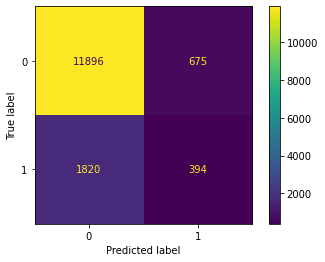

In [124]:
# Visualizing the confusion matrix for the random forest classifier
cfm = confusion_matrix(test_y, RF_pipe.predict(test_X))
ConfusionMatrixDisplay(cfm).plot()


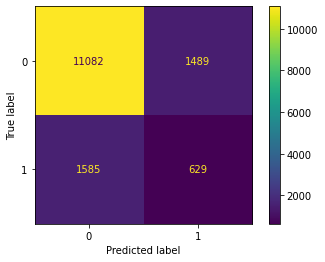

In [126]:
# Visualizing the confusion matrix for the decision tree classifier

cfm=confusion_matrix(test_y, tree_pipe.predict(test_X))
ConfusionMatrixDisplay(cfm).plot()

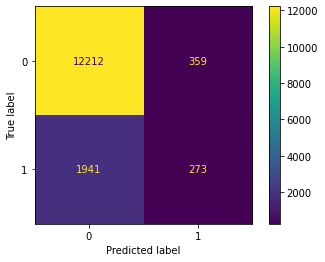

In [130]:
# Visualizing the confusion matrix for the logistic regression classifier

cfm=confusion_matrix(test_y, log_pipe.predict(test_X))
ConfusionMatrixDisplay(cfm).plot()

#### 4. Choosing the best model.

The decision tree classifier is the one with the highest capability to distinguish the minority class (1) in the test set. It correctly identified 28.4% of the positive examples. 
On the other hand the Random Forest classifier correctly predicted 17.9% of the positive examples and the Logistic Regression classifier made an exact prediction for 12.3% of the positive examples.
By assuming that "false negatives" (incorrectly identifying clients that will make a booking as not making a booking) are very expensive for the company we choose the Decision Tree classifier as the best model.

In [136]:
# Getting the classifier
clf = tree_pipe[-1]
clf

DecisionTreeClassifier(criterion='entropy', max_depth=24)

In [137]:
# Saving the classifier 
pickle.dump(clf, open('classifier_BA.sav', 'wb'))


In [141]:
# Getting the names of the selected features

# The selector object
selector = tree_pipe[1]

# The indices of the features
indx = selector.get_support(indices=True)

select_ftr = df.columns[indx]
print(select_ftr)

Index(['num_passengers', 'sales_channel', 'purchase_lead', 'length_of_stay',
       'flight_hour', 'flight_day', 'route', 'wants_extra_baggage',
       'wants_preferred_seat', 'wants_in_flight_meals', 'flight_duration'],
      dtype='object')


In [148]:
# The new dataframe with the selected features 
final_df = df[select_ftr]
final_df

,num_passengers,sales_channel,purchase_lead,length_of_stay,flight_hour,flight_day,route,wants_extra_baggage,wants_preferred_seat,wants_in_flight_meals,flight_duration
0,2,Internet,262,19,7,Sat,AKLDEL,1,0,0,5.52
1,1,Internet,112,20,3,Sat,AKLDEL,0,0,0,5.52
2,2,Internet,243,22,17,Wed,AKLDEL,1,1,0,5.52
3,1,Internet,96,31,4,Sat,AKLDEL,0,0,1,5.52
4,2,Internet,68,22,15,Wed,AKLDEL,1,0,1,5.52
...,...,...,...,...,...,...,...,...,...,...,...
49995,2,Internet,27,6,9,Sat,PERPNH,1,0,1,5.62
49996,1,Internet,111,6,4,Sun,PERPNH,0,0,0,5.62
49997,1,Internet,24,6,22,Sat,PERPNH,0,0,1,5.62
49998,1,Internet,15,6,11,Mon,PERPNH,1,0,1,5.62


In [146]:
# # Getting the names of the features after feature selection 
# Getting numerical features 
num_ftr = [col for col in final_df.columns if final_df[col].dtype in ['int64', 'float64']]

# Getting categorical features 
cat_ftr = [col for col in final_df.columns if col not in num_ftr]

print(len(num_ftr)+len(cat_ftr))

11


### V. Model interpretation using SHAP
SHAP is a technique used to interpret machine learning models. It explains a prediction by calculating what are known as Shapley values, which were developed in Game Theory. These values represent the contributions of the different explanatory variables to the prediction in question.

In [149]:
# Scaling numerical features 
scaler = SklearnTransformerWrapper(RobustScaler())
final_df = scaler.fit_transform(final_df)
final_df

,num_passengers,sales_channel,purchase_lead,length_of_stay,flight_hour,flight_day,route,wants_extra_baggage,wants_preferred_seat,wants_in_flight_meals,flight_duration
0,1.0,Internet,2.244681,0.086957,-0.250,Sat,AKLDEL,0.0,0.0,0.0,-0.638629
1,0.0,Internet,0.648936,0.130435,-0.750,Sat,AKLDEL,-1.0,0.0,0.0,-0.638629
2,1.0,Internet,2.042553,0.217391,1.000,Wed,AKLDEL,0.0,1.0,0.0,-0.638629
3,0.0,Internet,0.478723,0.608696,-0.625,Sat,AKLDEL,-1.0,0.0,1.0,-0.638629
4,1.0,Internet,0.180851,0.217391,0.750,Wed,AKLDEL,0.0,0.0,1.0,-0.638629
...,...,...,...,...,...,...,...,...,...,...,...
49995,1.0,Internet,-0.255319,-0.478261,0.000,Sat,PERPNH,0.0,0.0,1.0,-0.607477
49996,0.0,Internet,0.638298,-0.478261,-0.625,Sun,PERPNH,-1.0,0.0,0.0,-0.607477
49997,0.0,Internet,-0.287234,-0.478261,1.625,Sat,PERPNH,-1.0,0.0,1.0,-0.607477
49998,0.0,Internet,-0.382979,-0.478261,0.250,Mon,PERPNH,0.0,0.0,1.0,-0.607477


In [151]:
# Encoding categorical features 
enc = OrdinalEncoder()
final_df = enc.fit_transform(final_df, y)
final_df

,num_passengers,sales_channel,purchase_lead,length_of_stay,flight_hour,flight_day,route,wants_extra_baggage,wants_preferred_seat,wants_in_flight_meals,flight_duration
0,1.0,1,2.244681,0.086957,-0.250,3,0,0.0,0.0,0.0,-0.638629
1,0.0,1,0.648936,0.130435,-0.750,3,0,-1.0,0.0,0.0,-0.638629
2,1.0,1,2.042553,0.217391,1.000,6,0,0.0,1.0,0.0,-0.638629
3,0.0,1,0.478723,0.608696,-0.625,3,0,-1.0,0.0,1.0,-0.638629
4,1.0,1,0.180851,0.217391,0.750,6,0,0.0,0.0,1.0,-0.638629
...,...,...,...,...,...,...,...,...,...,...,...
49995,1.0,1,-0.255319,-0.478261,0.000,3,122,0.0,0.0,1.0,-0.607477
49996,0.0,1,0.638298,-0.478261,-0.625,0,122,-1.0,0.0,0.0,-0.607477
49997,0.0,1,-0.287234,-0.478261,1.625,3,122,-1.0,0.0,1.0,-0.607477
49998,0.0,1,-0.382979,-0.478261,0.250,4,122,0.0,0.0,1.0,-0.607477


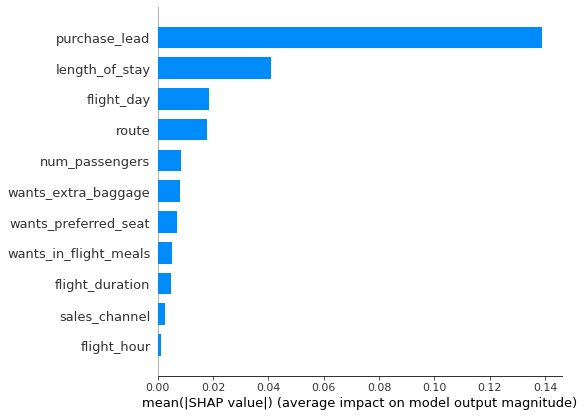

In [152]:
# The code to get shap values 
explainer = shap.TreeExplainer(clf)
shap_values = explainer.shap_values(final_df)

# Plotting feature importance 
shap.summary_plot(shap_values[0], final_df, max_display=26, plot_type='bar')


The three most predictive features are :
- Purchase lead.
- Length of stay.
- Flight day.

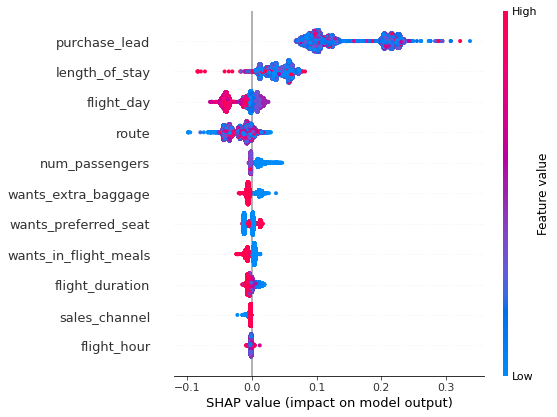

In [154]:
# Investigating the global effect of each feature on the model output(pushing it down or up).
shap.summary_plot(shap_values[0], final_df, max_display=26)

From this visual we can conclude that:

- A small purchase lead (the  number of days between travel date and booking date) increases the chances of the client completing the booking.
- A longer period of stay influences negatively the chances of the client completing the booking.
- When the number of passengers is high, the client is less likely to make a booking.
- Asking for extra baggage and a flight meal decreases the chances of the client completing the booking.
- Making a booking on the weekend (according to the encoding of the feature flight day) increases its chances to be completed.






 